In [1]:
# Ensure dependencies are installed into colab environment
!pip install zarr gcsfs momlevel cftime cmocean eccodes cfgrib pygrib cartopy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 208.5/208.5 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.9/8.9 MB 16.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 27.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 421.9/421.9 kB 24.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 24.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.6/47.6 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.1/18.1 MB 38.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 38.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 47.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 54.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.6/95.6 kB 8.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... 

In [2]:
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import zarr
import gcsfs
import cftime
import cmocean
import pygrib
import cartopy.crs as ccrs

import xarray as xr
xr.set_options(display_style='html')
%matplotlib inline
%config InlineBackend.figure_format='retina'
plt.rcParams['figure.figsize'] = 12,6

In [3]:
# Only needs to be created once per notebook session
gcs = gcsfs.GCSFileSystem(token='anon')

In [4]:
# Load Google Cloud Storage data from CMIP6
google_cloud_cmip6 = pd.read_csv('https://storage.googleapis.com/cmip6/cmip6-zarr-consolidated-stores.csv')

# Filter for monthly atmospheric data (Amon) for historical simulations that are measuring near-surface air temperature
historical_tas_data = google_cloud_cmip6.query(
    "experiment_id=='historical' & \
    table_id == 'Amon' & \
    variable_id == 'tas'"
)

# Filter manually for member IDs that start with 'r1i' indicating they are the first ensemble member of the project
historical_tas_data = historical_tas_data[historical_tas_data['member_id'].str.startswith('r1i')]
historical_tas_data

,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
8074,CMIP,NOAA-GFDL,GFDL-CM4,historical,r1i1p1f1,Amon,tas,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-CM4/histo...,NaN,20180701
29231,CMIP,IPSL,IPSL-CM6A-LR,historical,r1i1p1f1,Amon,tas,gr,gs://cmip6/CMIP6/CMIP/IPSL/IPSL-CM6A-LR/histor...,NaN,20180803
32351,CMIP,NASA-GISS,GISS-E2-1-G,historical,r1i1p1f1,Amon,tas,gn,gs://cmip6/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G/hi...,NaN,20180827
37798,CMIP,CNRM-CERFACS,CNRM-CM6-1,historical,r1i1p1f2,Amon,tas,gr,gs://cmip6/CMIP6/CMIP/CNRM-CERFACS/CNRM-CM6-1/...,NaN,20180917
43297,CMIP,BCC,BCC-CSM2-MR,historical,r1i1p1f1,Amon,tas,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-CSM2-MR/historic...,NaN,20181126
...,...,...,...,...,...,...,...,...,...,...,...
513653,CMIP,MIROC,MIROC-ES2H,historical,r1i1p1f2,Amon,tas,gn,gs://cmip6/CMIP6/CMIP/MIROC/MIROC-ES2H/histori...,NaN,20210125
514701,CMIP,MPI-M,ICON-ESM-LR,historical,r1i1p1f1,Amon,tas,gn,gs://cmip6/CMIP6/CMIP/MPI-M/ICON-ESM-LR/histor...,NaN,20210215
514846,CMIP,IPSL,IPSL-CM6A-LR-INCA,historical,r1i1p1f1,Amon,tas,gr,gs://cmip6/CMIP6/CMIP/IPSL/IPSL-CM6A-LR-INCA/h...,NaN,20210216
521076,CMIP,KIOST,KIOST-ESM,historical,r1i1p1f1,Amon,tas,gr1,gs://cmip6/CMIP6/CMIP/KIOST/KIOST-ESM/historic...,NaN,20210601


In [5]:
gfdl_zs = historical_tas_data.zstore.values[0]
# Create a mutable-mapping-style interface to the store
ms = gcs.get_mapper(gfdl_zs)
# Open the dataset using xarray and zarr
gfdl_tas = xr.open_zarr(ms, consolidated=True,use_cftime=True).tas.rename({'lat':'latitude', 'lon':'longitude'})
gfdl_tas

/usr/local/lib/python3.10/dist-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'cfgrib' loading failed:
Cannot find the ecCodes library
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)


<xarray.DataArray 'tas' (time: 1980, latitude: 180, longitude: 288)>
dask.array<open_dataset-tas, shape=(1980, 180, 288), dtype=float32, chunksize=(600, 180, 288), chunktype=numpy.ndarray>
Coordinates:
    height     float64 ...
  * latitude   (latitude) float64 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5
  * longitude  (longitude) float64 0.625 1.875 3.125 4.375 ... 356.9 358.1 359.4
  * time       (time) object 1850-01-16 12:00:00 ... 2014-12-16 12:00:00
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    interp_method:  conserve_order2
    long_name:      Near-Surface Air Temperature
    original_name:  tas
    standard_name:  air_temperature
    units:          K

In [6]:
# Note structure of cftime DatetimeNoLeap objects in time coordinate
# Filter based on start and end dates of analysis using cftime
start_date = cftime.DatetimeNoLeap(1994, 1, 1, 0, 0, 0, 0, has_year_zero=True)
end_date = cftime.DatetimeNoLeap(2014, 12, 31, 23, 59, 59, 0, has_year_zero=True)

# Filter the DataFrame for the date range
gfdl = gfdl_tas[(gfdl_tas['time'] >= start_date) & (gfdl_tas['time'] <= end_date)]
gfdl

<xarray.DataArray 'tas' (time: 252, latitude: 180, longitude: 288)>
dask.array<getitem, shape=(252, 180, 288), dtype=float32, chunksize=(180, 180, 288), chunktype=numpy.ndarray>
Coordinates:
    height     float64 ...
  * latitude   (latitude) float64 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5
  * longitude  (longitude) float64 0.625 1.875 3.125 4.375 ... 356.9 358.1 359.4
  * time       (time) object 1994-01-16 12:00:00 ... 2014-12-16 12:00:00
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    interp_method:  conserve_order2
    long_name:      Near-Surface Air Temperature
    original_name:  tas
    standard_name:  air_temperature
    units:          K

In [40]:
# Load ERA5 dataset from file
gribfilepath = 'era5_monthly_1994_2014_2mk.grib'
era5_grib = pygrib.open(gribfilepath)

In [57]:
# Note that latitude index of ERA5 data is flipped relative to GFDL dataset
# The following method reindex GFDL data to match ERA5, and may be useful in other examples
gfdl = gfdl.reindex(latitude=gfdl.latitude[::-1])
gfdl

<xarray.DataArray 'tas' (time: 252, latitude: 180, longitude: 288)>
dask.array<getitem, shape=(252, 180, 288), dtype=float32, chunksize=(180, 180, 288), chunktype=numpy.ndarray>
Coordinates:
  * latitude   (latitude) float64 89.5 88.5 87.5 86.5 ... -87.5 -88.5 -89.5
  * longitude  (longitude) float64 0.625 1.875 3.125 4.375 ... 356.9 358.1 359.4
  * time       (time) object 1994-01-16 12:00:00 ... 2014-12-16 12:00:00
    height     float64 ...
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    interp_method:  conserve_order2
    long_name:      Near-Surface Air Temperature
    original_name:  tas
    standard_name:  air_temperature
    units:          K

In [58]:
# Summary Analysis

years = range(1994, 2015)

# First calculate differences between GFDL and ERA5 data
# In practice, this is always (model - observed)
# Then, stack data and convert to a new DataArray
model_diff = []
years = range(1994, 2015)
for i in range(len(years)):
  era5_slice = era5_grib.select(name = '2 metre temperature', year = years[i])
  for j in range(12):
    model_diff.append(gfdl[i*12 + j] - era5_slice[j].values)

data_stack = xr.concat(model_diff, dim="time")
data_stack = data_stack.assign_coords(year=("time", np.repeat(np.arange(21), 12)))
annual_mean = data_stack.groupby('year').mean('time')
overall_mean = annual_mean.mean('year')
overall_mean

<xarray.DataArray 'tas' (latitude: 180, longitude: 288)>
dask.array<mean_agg-aggregate, shape=(180, 288), dtype=float64, chunksize=(180, 288), chunktype=numpy.ndarray>
Coordinates:
  * latitude   (latitude) float64 89.5 88.5 87.5 86.5 ... -87.5 -88.5 -89.5
  * longitude  (longitude) float64 0.625 1.875 3.125 4.375 ... 356.9 358.1 359.4
    height     float64 ...

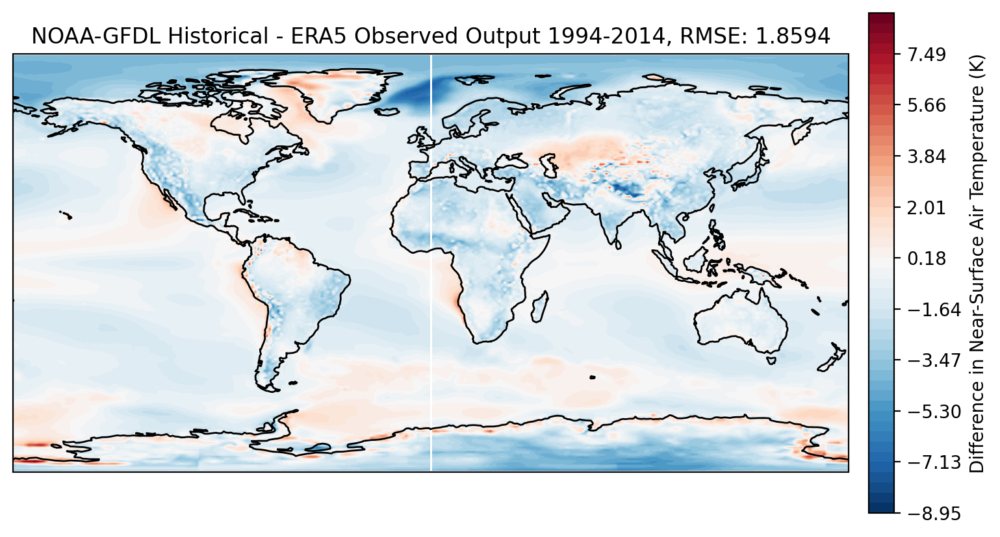

In [74]:
# Plot overall mean along axes using cartopy projection
lmax = overall_mean.max()

fig, ax = plt.subplots(figsize=(10, 5), subplot_kw={'projection': ccrs.PlateCarree()})
ax.set_global()
ax.coastlines()

plt.title('NOAA-GFDL Historical - ERA5 Observed Output 1994-2014, RMSE: ' + str(np.round((np.sqrt((overall_mean ** 2).mean())).values, 4)))
contour = ax.contourf(np.linspace(.625, 359.375, 288), np.linspace(89.5, -89.5, 180), overall_mean, levels=np.linspace(-1*lmax, lmax, 50),
                      transform=ccrs.PlateCarree(), cmap='RdBu_r')

plt.colorbar(contour, ax=ax, orientation='vertical', pad=0.02, label='Difference in Near-Surface Air Temperature (K)')

plt.show()

In [76]:
# Preparation for Spectral Clustering Analysis

# Load ERA5 dataset using Pygrib
# To import the file, select the folder icon on the left sidebar in Colab, then click the file icon with an arrow to import the .grib file
# Note: This file has been pre-emptively gridded into the correct grid for the NOAA-GFDL model output
gribfilepath = 'era5_monthly_1994_2014_2mk.grib'
era5_grib = pygrib.open(gribfilepath)

# Now convert ERA5 data to an xarray DataArray
# Prepare lists to hold ERA5 data, times, latitudes, and longitudes
era5_data = []
era5_times = []
lats = None
lons = None
attrs = {}

# Loop through each message in the GRIB file
for grib in era5_grib:
    # This is necessary due to the way pygrib reads .grib files
    if lats is None or lons is None:
        lats, lons = grib.latlons()

    # Can grab other attributes and put them here as necessary
    if 'description' not in attrs:
        attrs['description'] = grib.name
        attrs['units'] = grib.units

    era5_data.append(grib.values)
    era5_times.append(cftime.DatetimeNoLeap(grib.validDate.year, grib.validDate.month, 1, 0, 0))

era5_grib.close()

era5_data = np.array(era5_data)

# grib.latlons() produces 2D arrays for latitude and longitude; reduce to one row/column respectively
era5_lats = lats[:, 0]
era5_lons = lons[0, :]

era5 = xr.DataArray(era5_data, coords=[('time', era5_times), ('latitude', era5_lats), ('longitude', era5_lons)],
                          dims=['time', 'latitude', 'longitude'], attrs=attrs)

era5

<xarray.DataArray (time: 252, latitude: 180, longitude: 288)>
array([[[244.3914032 , 244.3914032 , 244.3914032 , ..., 244.3914032 ,
         244.3914032 , 244.3914032 ],
        [244.55937195, 244.56523132, 244.5710907 , ..., 244.55937195,
         244.55937195, 244.55741882],
        [244.5554657 , 244.53593445, 244.51445007, ..., 244.5398407 ,
         244.54960632, 244.55937195],
        ...,
        [244.7351532 , 244.66093445, 244.58866882, ..., 244.8601532 ,
         244.83085632, 244.7976532 ],
        [244.56913757, 244.53398132, 244.49882507, ..., 244.67070007,
         244.63749695, 244.60429382],
        [244.44023132, 244.44023132, 244.44023132, ..., 244.43632507,
         244.4382782 , 244.44023132]],

       [[246.31713867, 246.31518555, 246.31518555, ..., 246.32104492,
         246.3190918 , 246.31713867],
        [246.85229492, 246.86010742, 246.86987305, ..., 246.83081055,
         246.83862305, 246.84448242],
        [246.85229492, 246.8972168 , 246.94213867, ..., 246.63354492,
         246.71362305, 246.79174805],
...
        [237.94219971, 237.88165283, 237.82305908, ..., 238.05548096,
         238.03204346, 238.00469971],
        [237.52032471, 237.48712158, 237.45196533, ..., 237.61798096,
         237.58673096, 237.55352783],
        [237.33868408, 237.34454346, 237.35235596, ..., 237.32891846,
         237.33282471, 237.33477783]],

       [[252.28939819, 252.30111694, 252.31283569, ..., 252.26400757,
         252.27182007, 252.28158569],
        [252.33822632, 252.37338257, 252.40853882, ..., 252.25619507,
         252.28158569, 252.30892944],
        [252.26986694, 252.32455444, 252.38119507, ..., 252.05697632,
         252.13119507, 252.20541382],
        ...,
        [247.30892944, 247.23666382, 247.16635132, ..., 247.43978882,
         247.40658569, 247.36947632],
        [246.97103882, 246.93783569, 246.90267944, ..., 247.07650757,
         247.04135132, 247.00619507],
        [246.62728882, 246.62338257, 246.61752319, ..., 246.64291382,
         246.63705444, 246.63314819]]])
Coordinates:
  * time       (time) object 1994-01-01 00:00:00 ... 2014-12-01 00:00:00
  * latitude   (latitude) float64 89.5 88.5 87.5 86.5 ... -87.5 -88.5 -89.5
  * longitude  (longitude) float64 0.625 1.875 3.125 4.375 ... 356.9 358.1 359.4
Attributes:
    description:  2 metre temperature
    units:        K

In [89]:
from sklearn.cluster import SpectralClustering
from sklearn.neighbors import kneighbors_graph

def SpecClusterMap(dataset, k, n):
  # Function to perform spectral clustering on a DataArray
  times = [cftime.DatetimeNoLeap(year, month, 15) for year in range(1994, 2015) for month in range(1, 13)]
  da = xr.DataArray(dataset, coords=[times, np.linspace(-89.5, 89.5, 180), np.linspace(.625, 359.375, 288)], dims=["time", "lat", "lon"])

  da.coords['month'] = ('time', [t.month for t in da.coords['time'].values])
  da.coords['year'] = ('time', [t.year for t in da.coords['time'].values])

  # Filter to include only years from 1994 to 2014 and group by month to calculate the mean
  filtered_da = da.where((da.coords['year'] >= 1994) & (da.coords['year'] <= 2014), drop=True)
  monthly_mean = filtered_da.groupby('month').mean('time')

  # Convert data into an array for clustering; transpose into (pixel, time)
  data_array = monthly_mean.values
  n_time, height, width = data_array.shape
  data_for_clustering = data_array.reshape(n_time, height * width).T

  # Spectral Clustering Algorithm
  connectivity = kneighbors_graph(data_for_clustering, n_neighbors=n, mode='connectivity')
  spectral = SpectralClustering(n_clusters=k, affinity='precomputed', assign_labels='kmeans', random_state=0)
  labels = spectral.fit_predict(connectivity)

  # Reshape labels back to the original grid format
  cm_labels_reshaped = labels.reshape(height, width)

  return cm_labels_reshaped

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


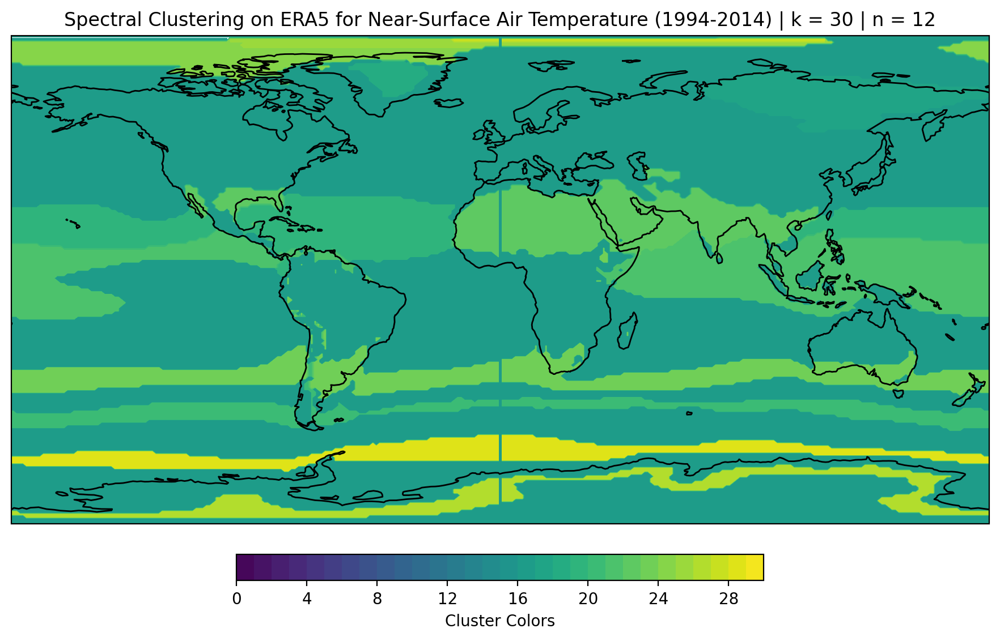

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


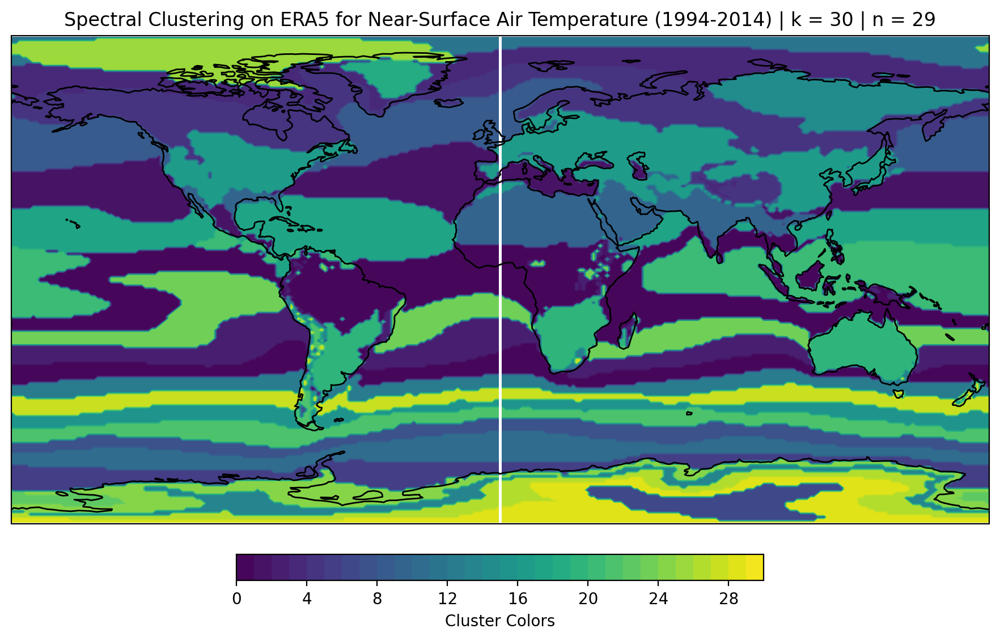

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


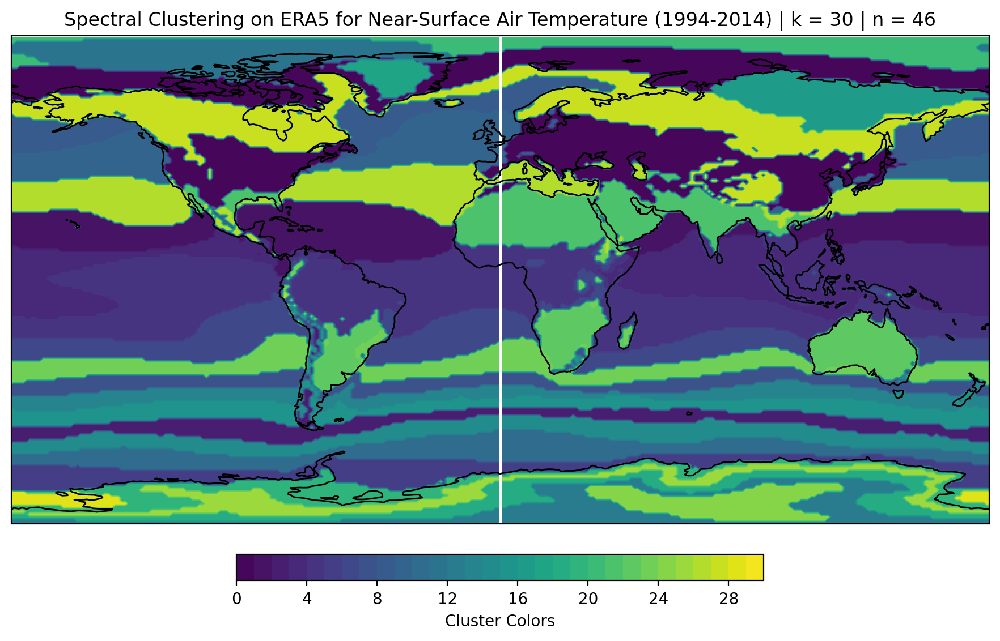

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


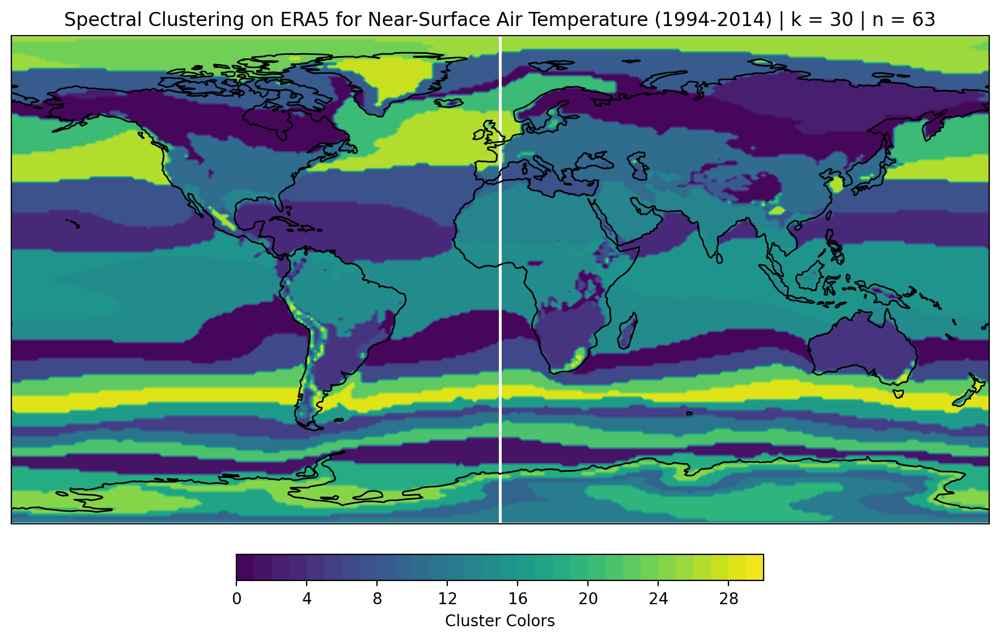

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


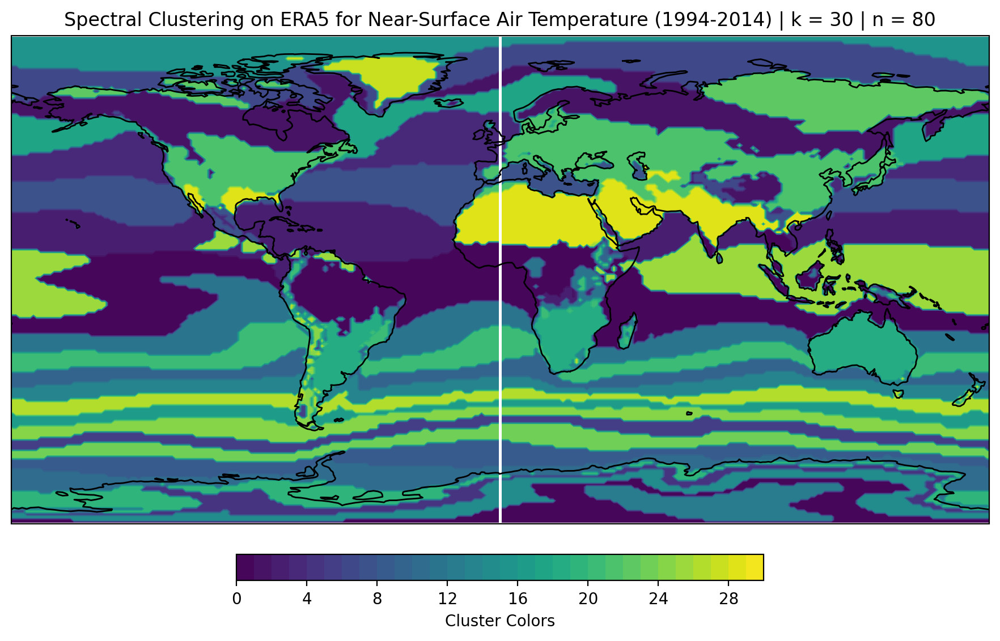

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


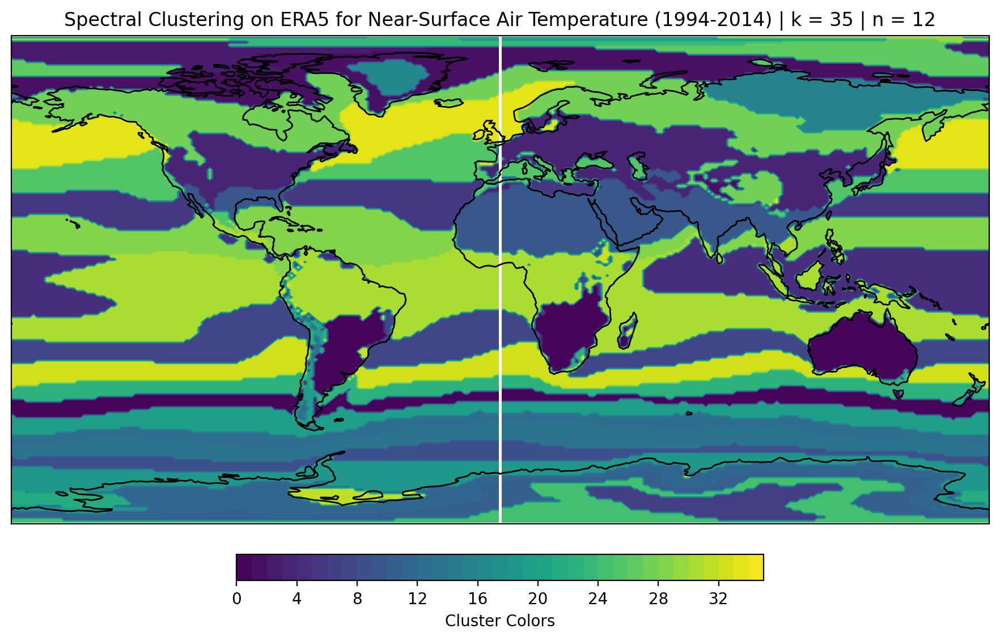

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


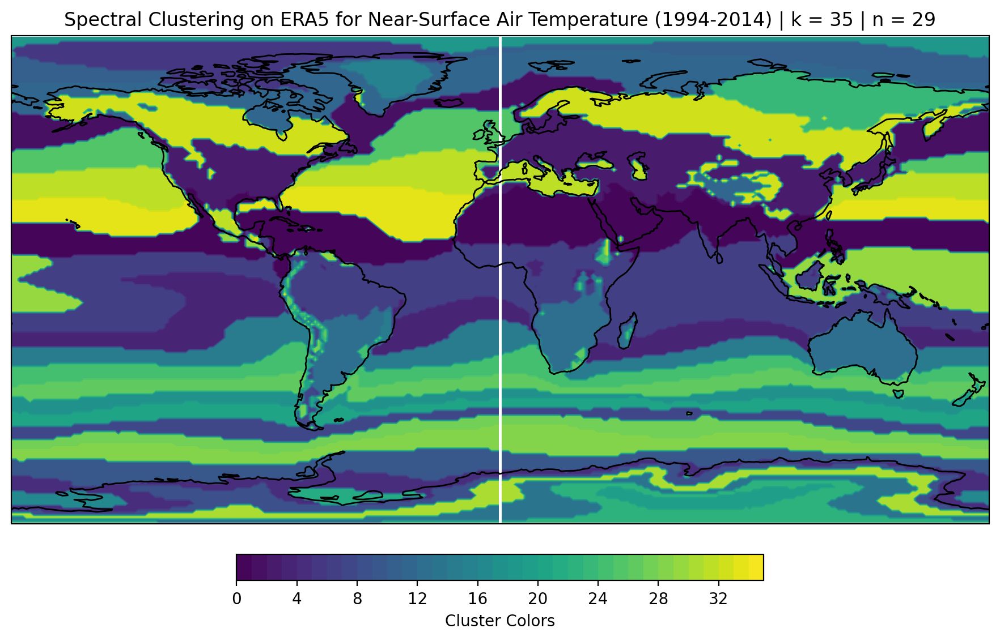

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


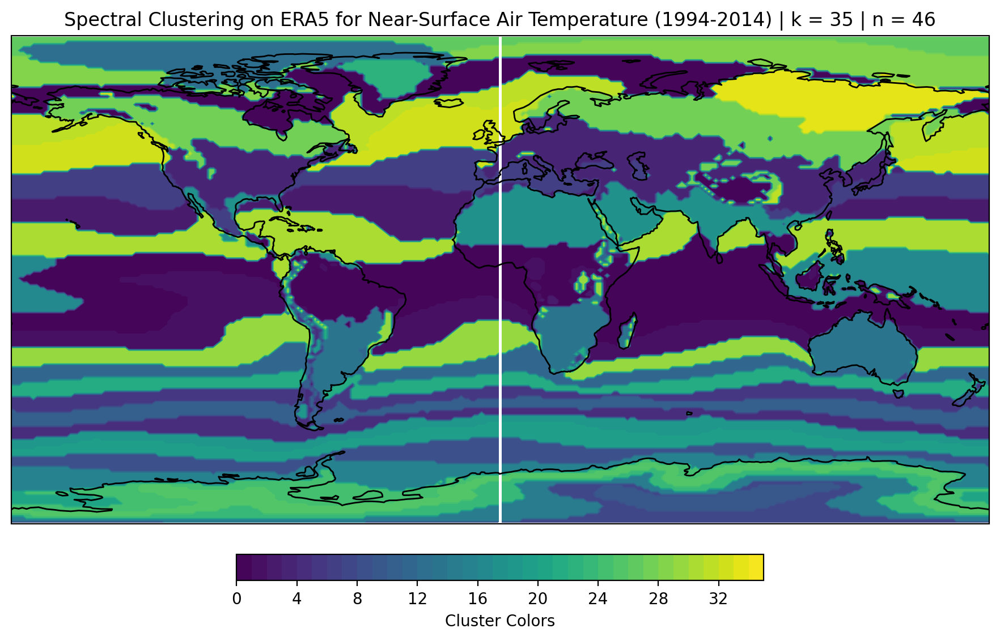

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


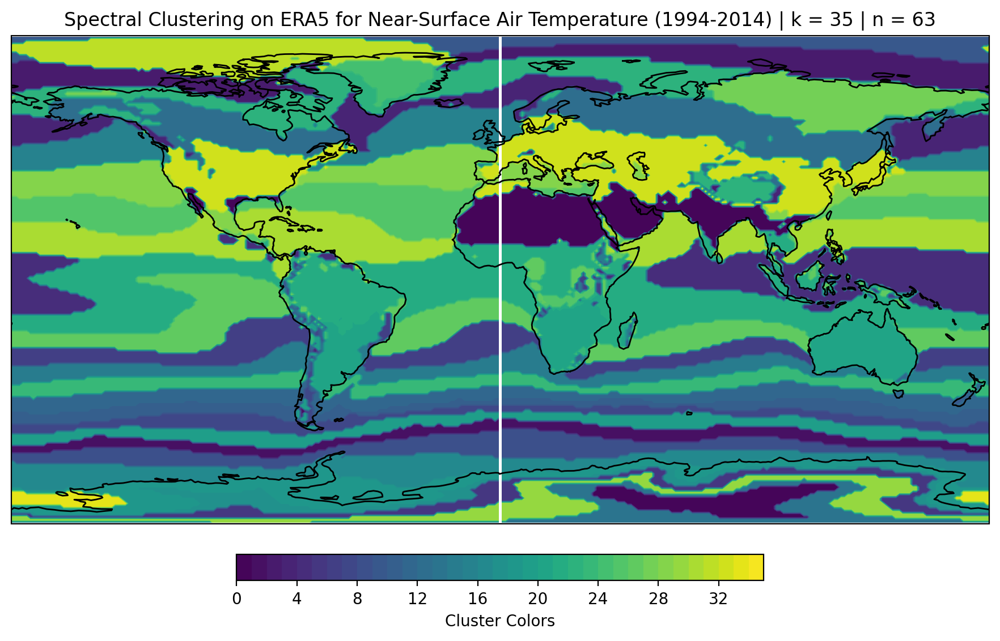

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


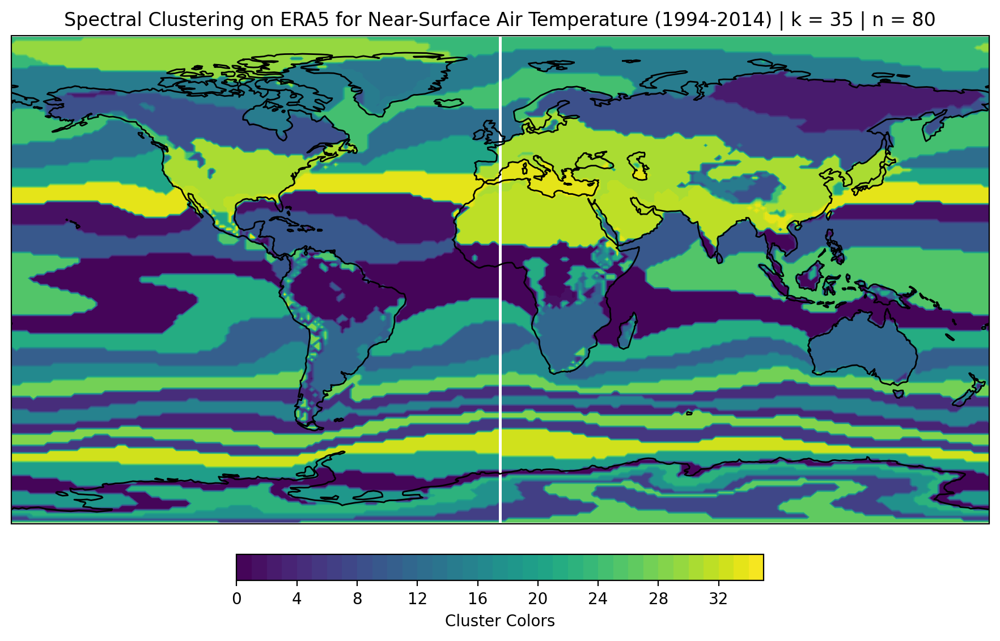

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


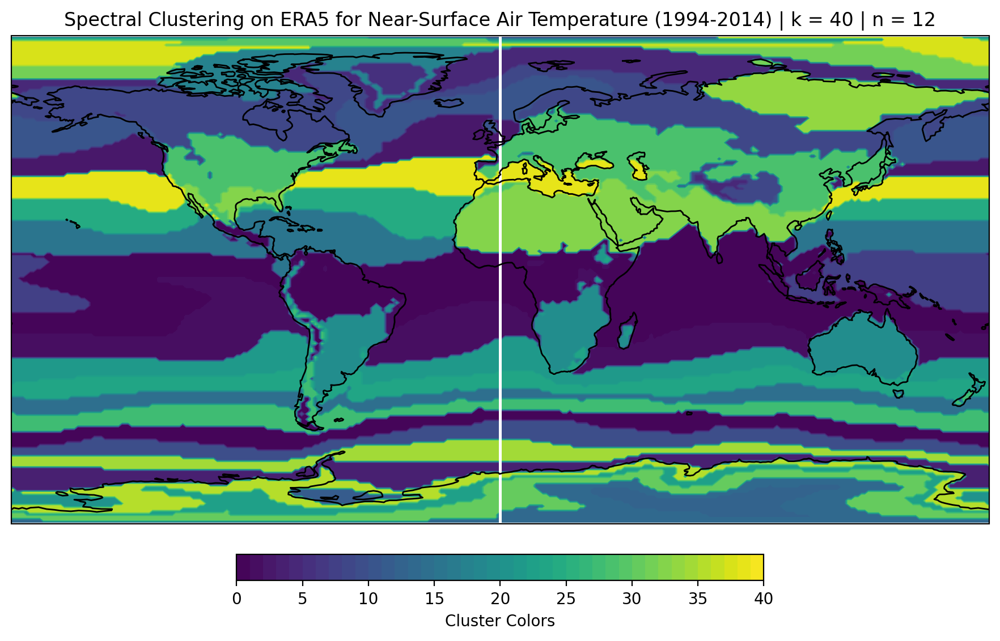

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


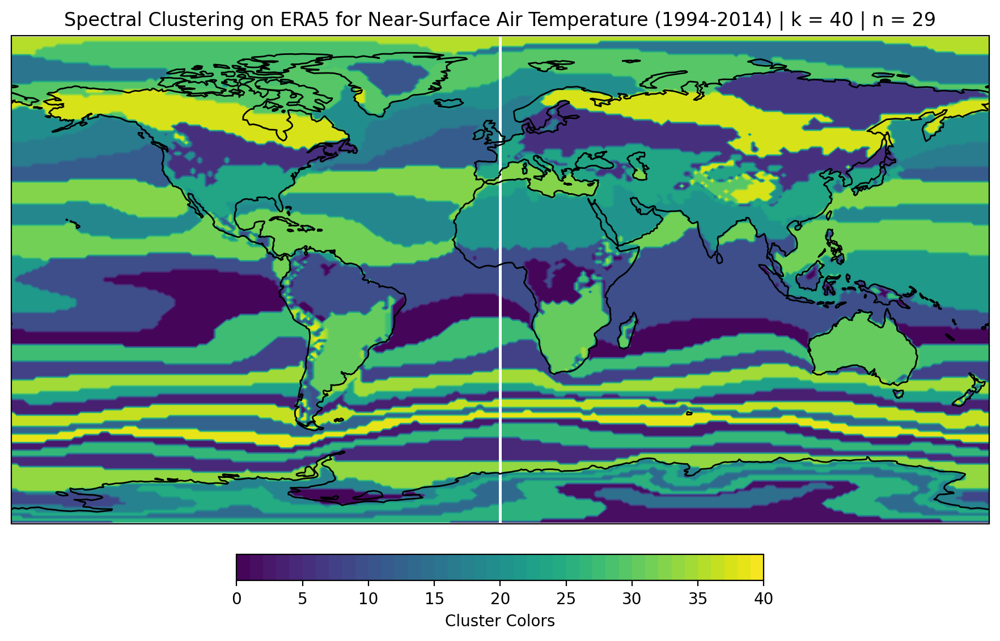

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


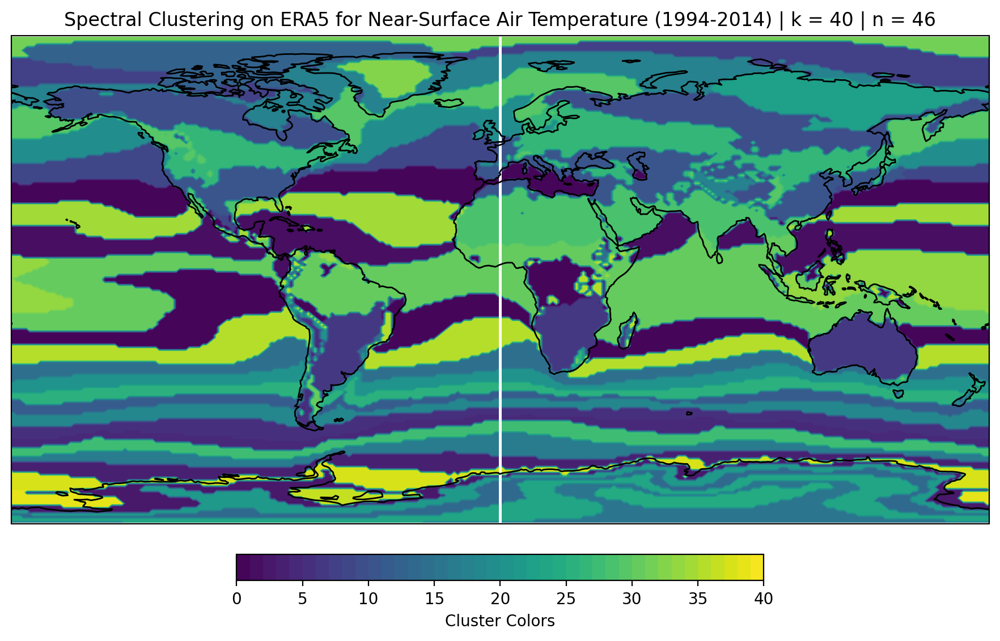

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


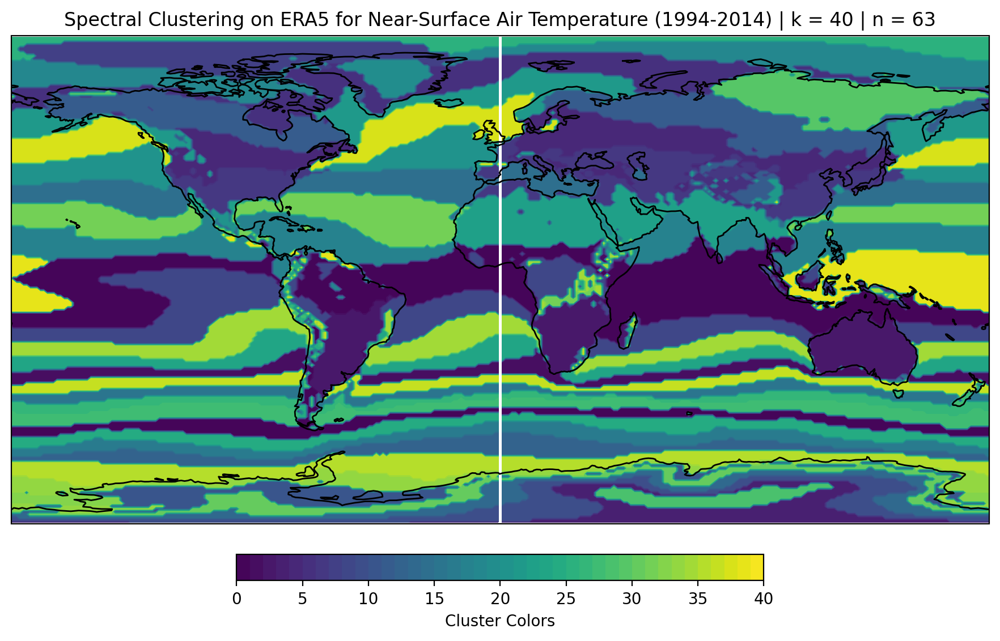

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


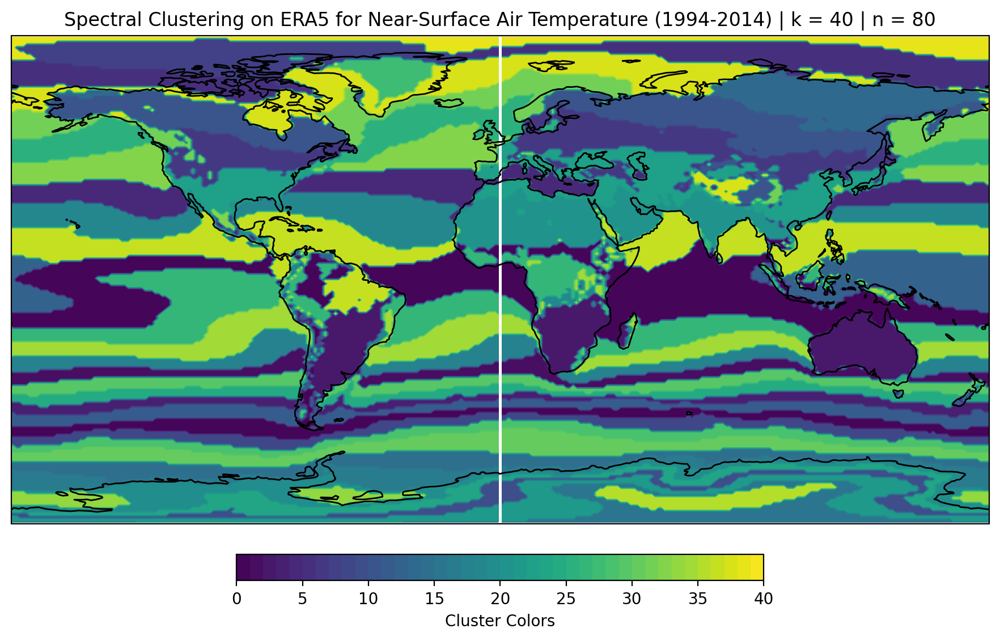

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


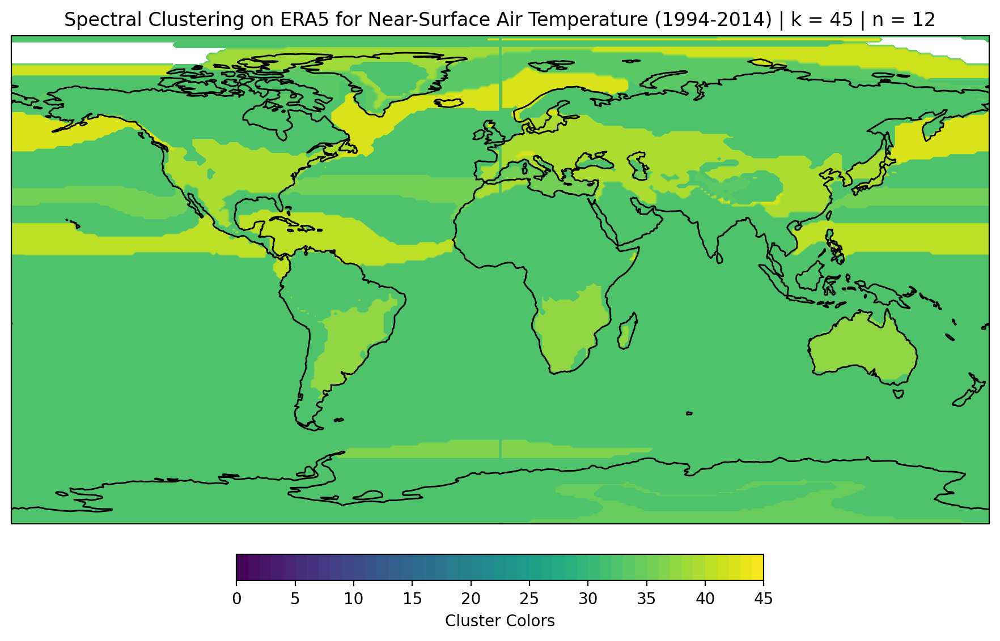

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


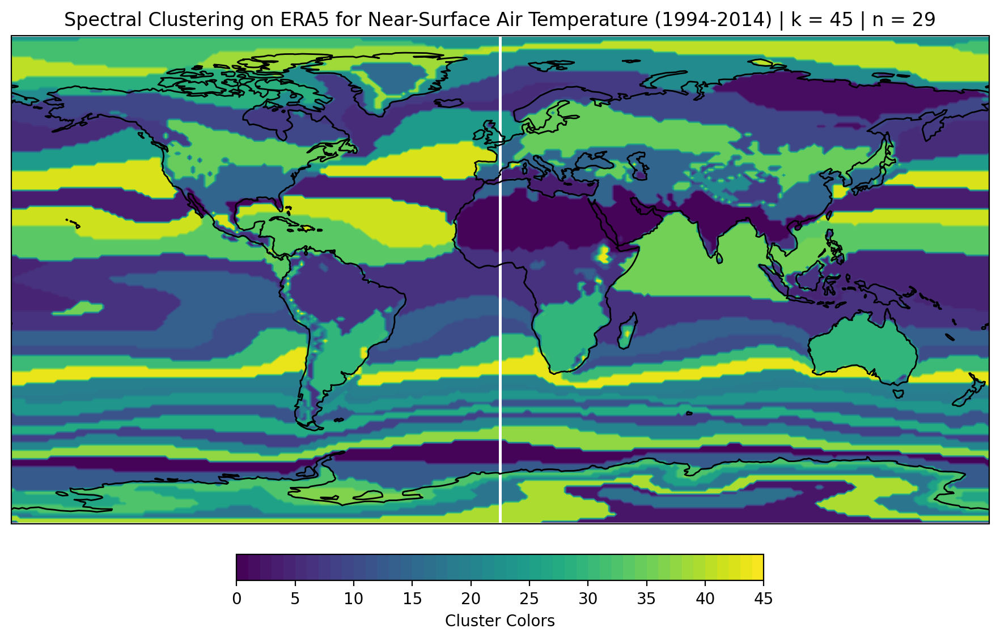

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


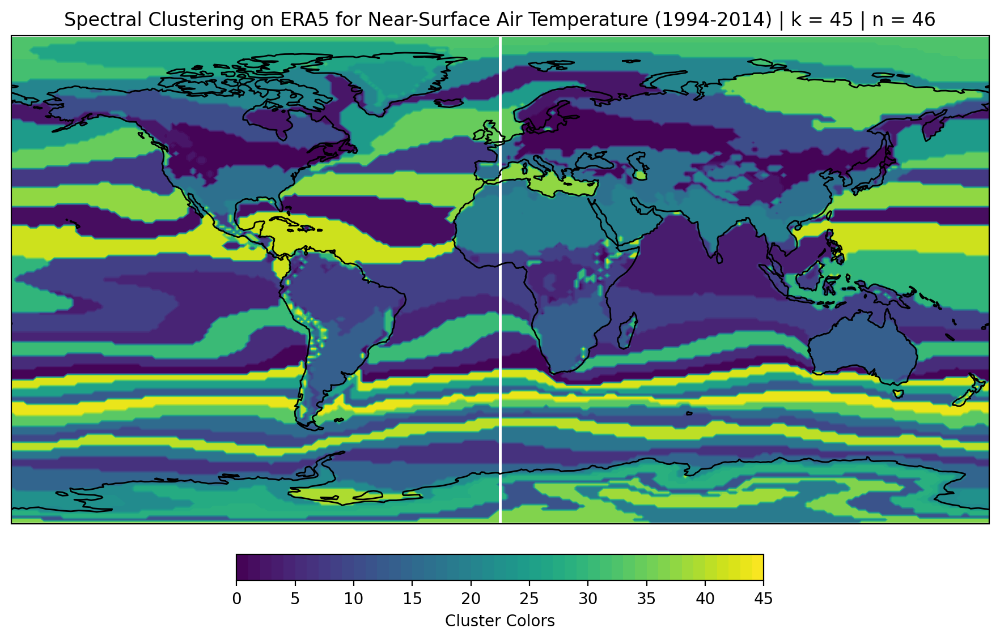

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


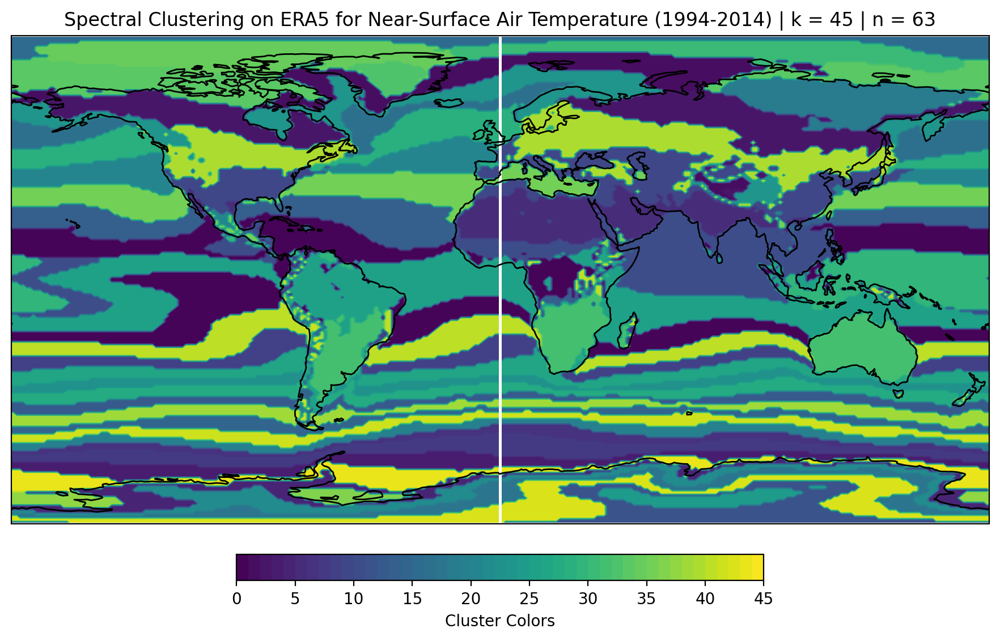

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


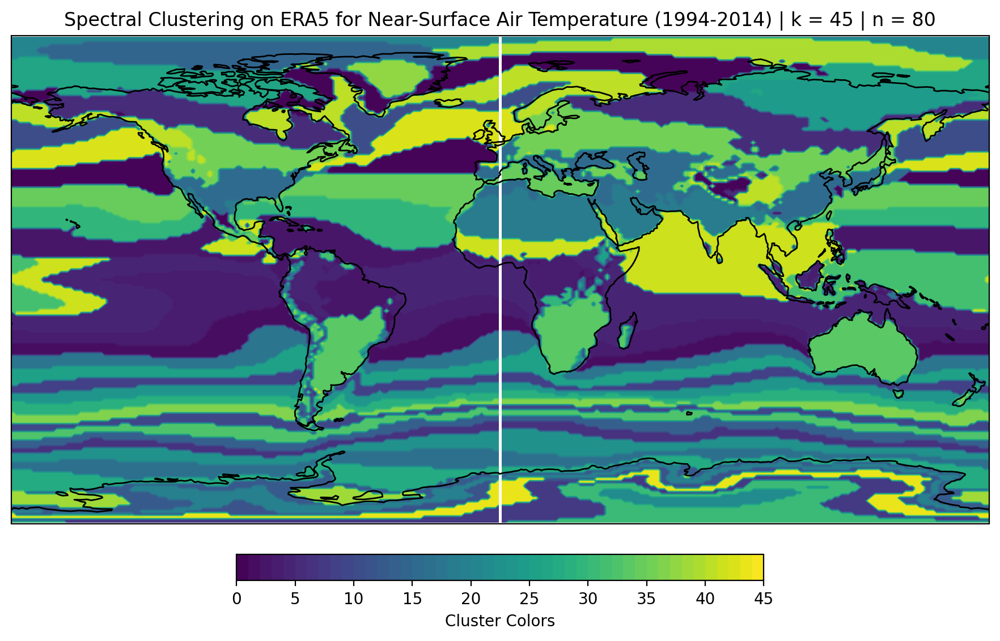

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


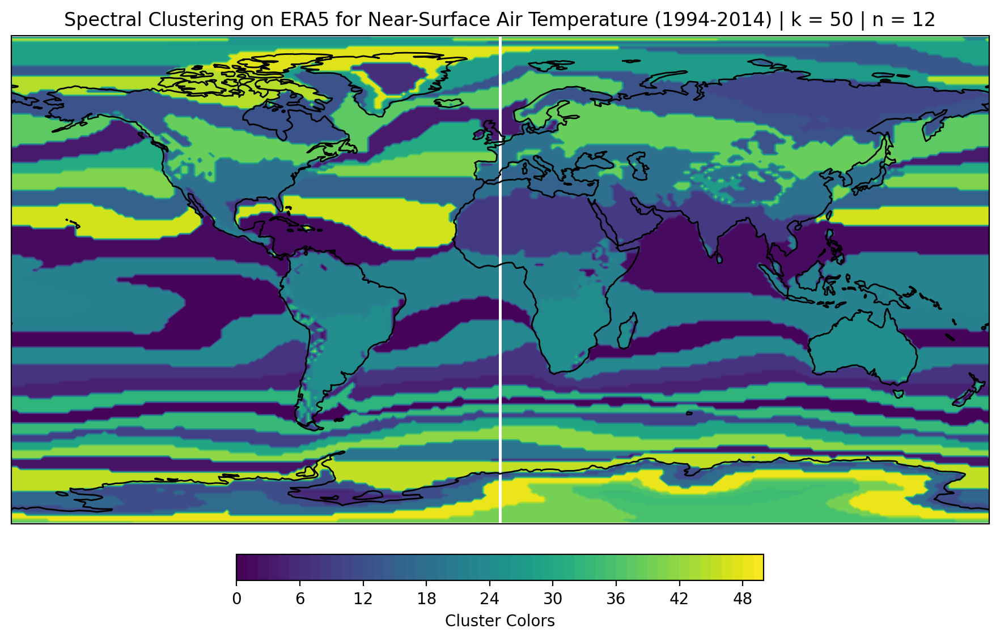

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


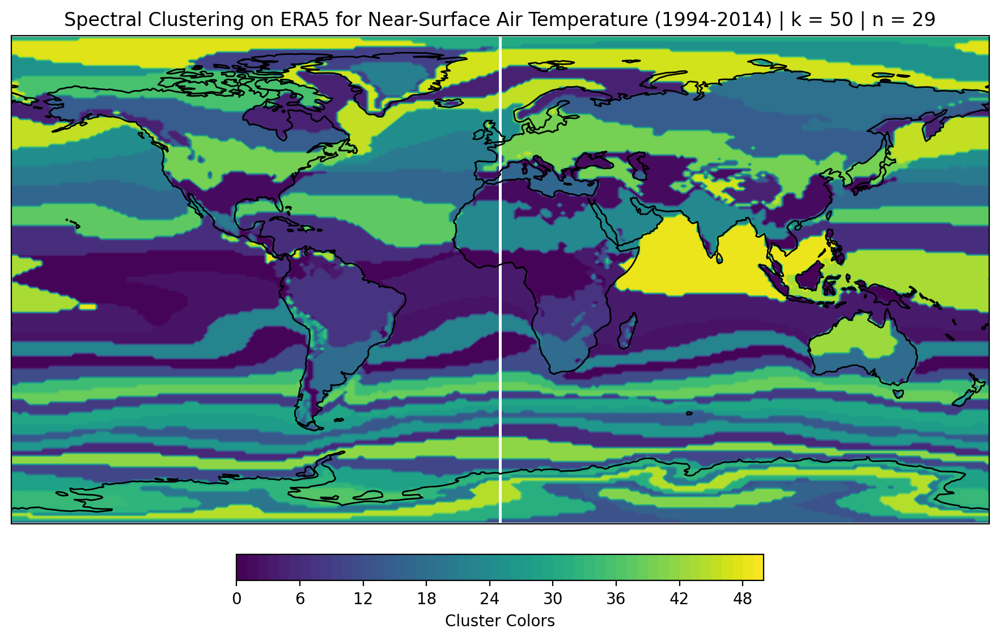

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


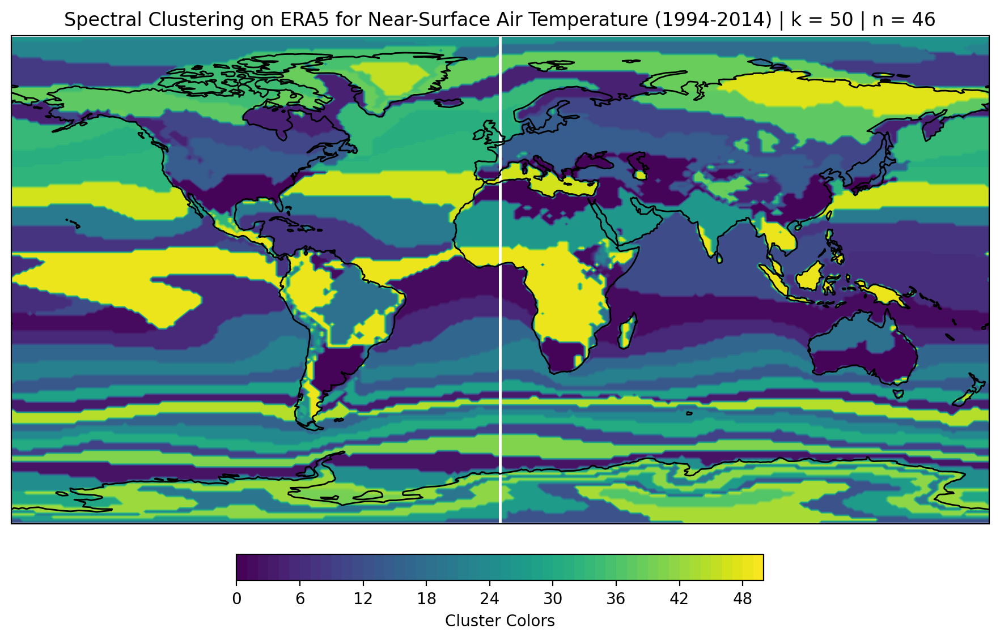

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


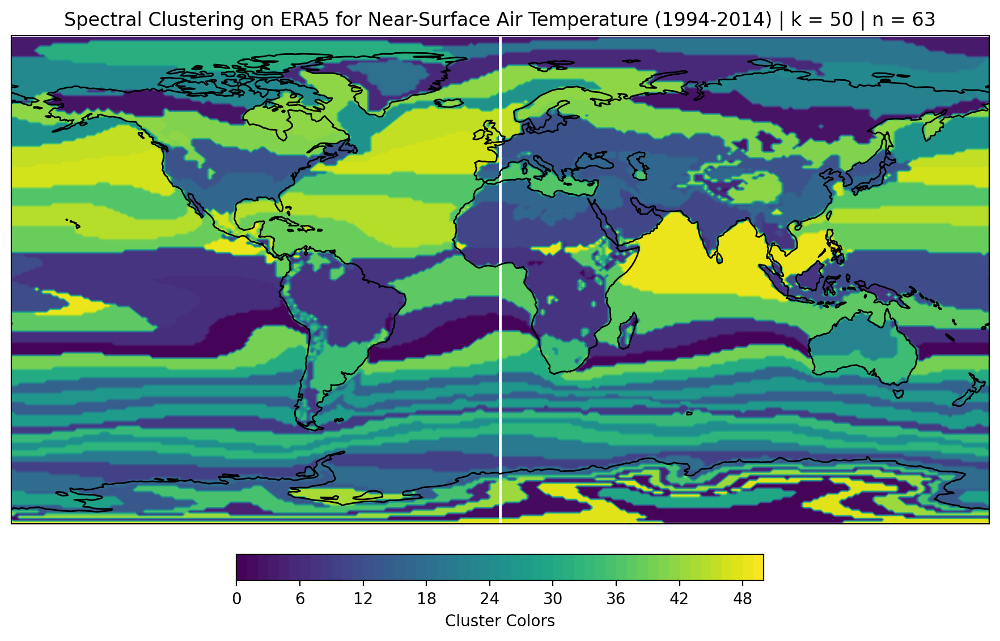

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


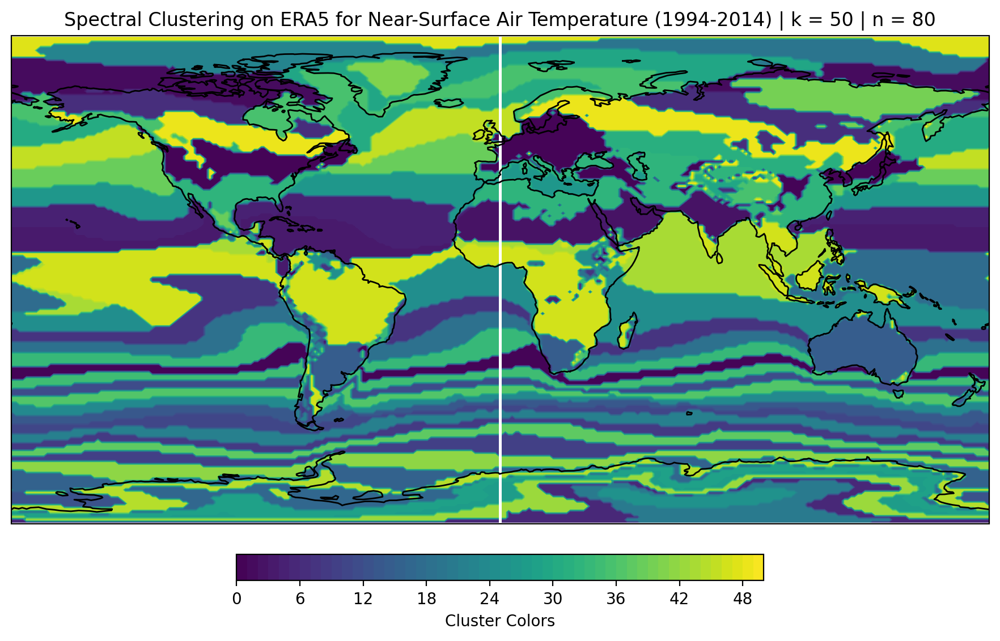

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


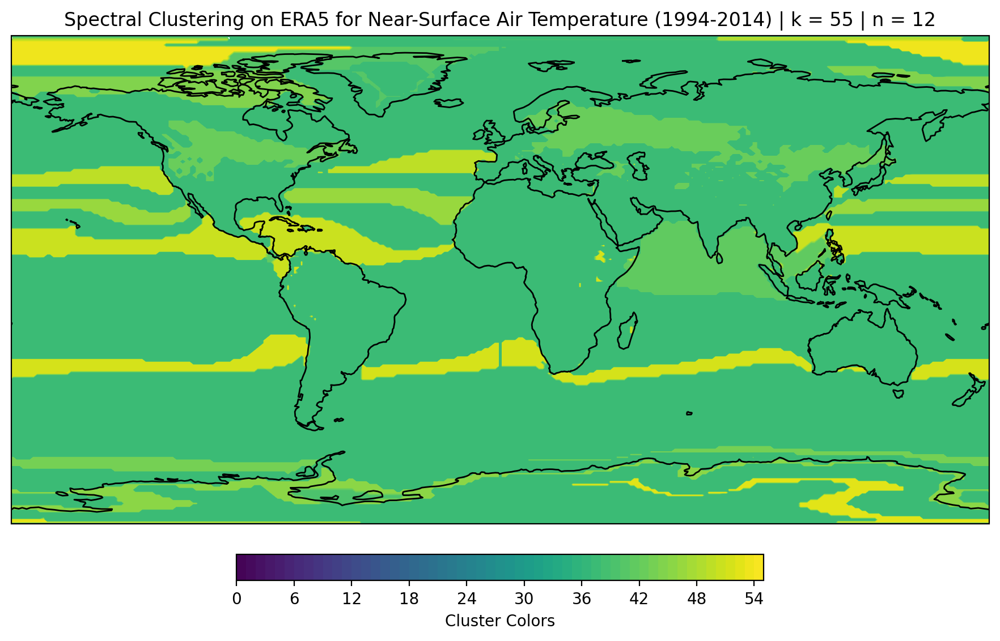

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


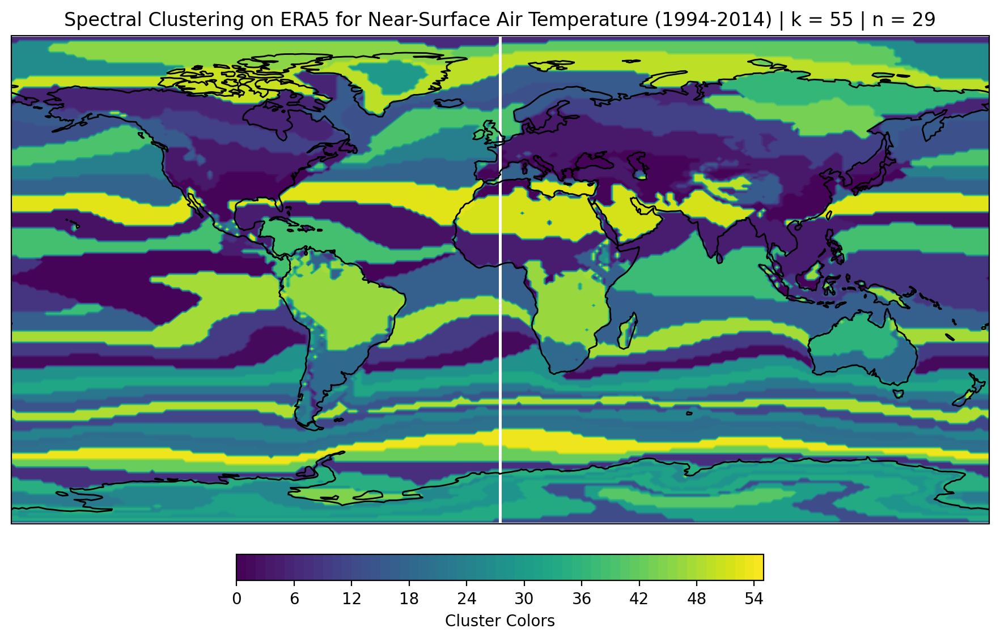

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


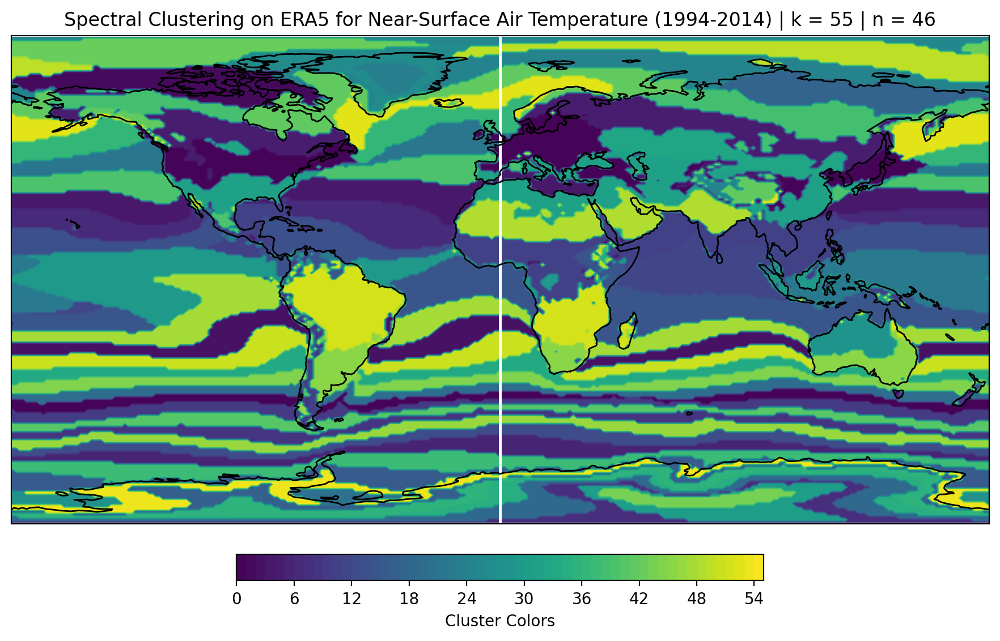

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


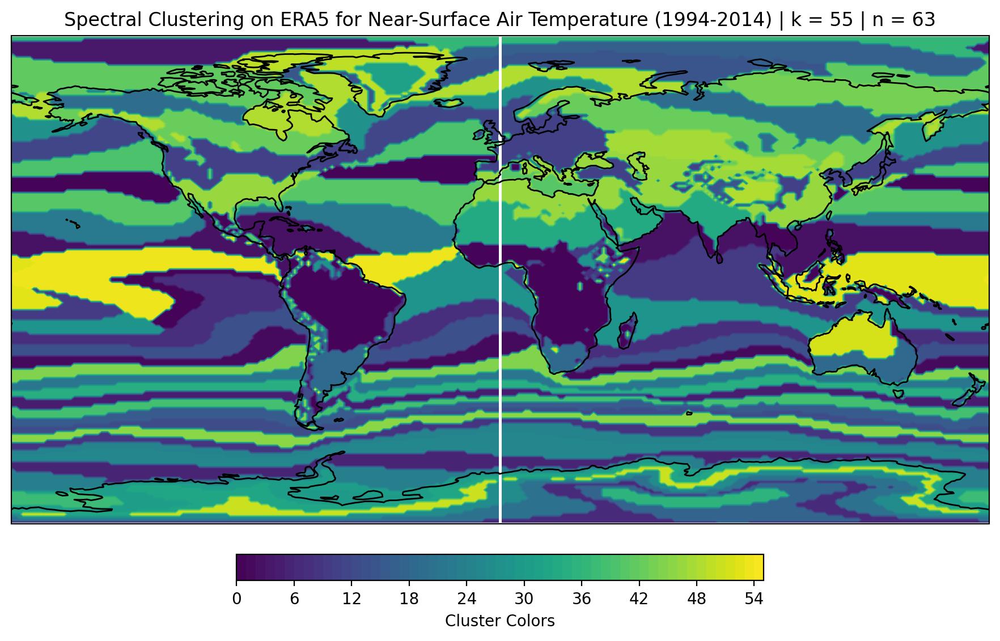

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


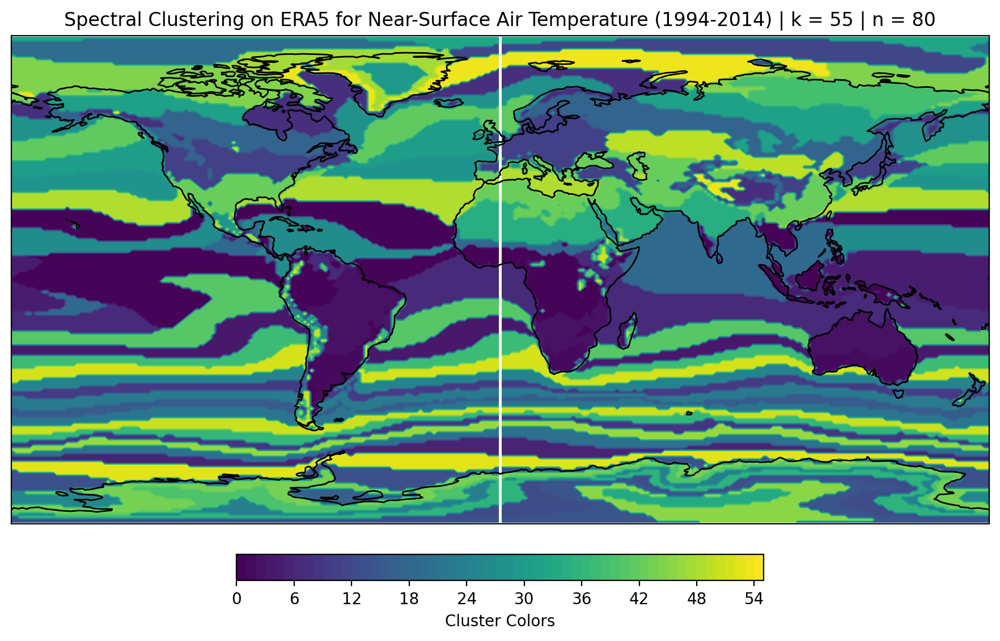

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


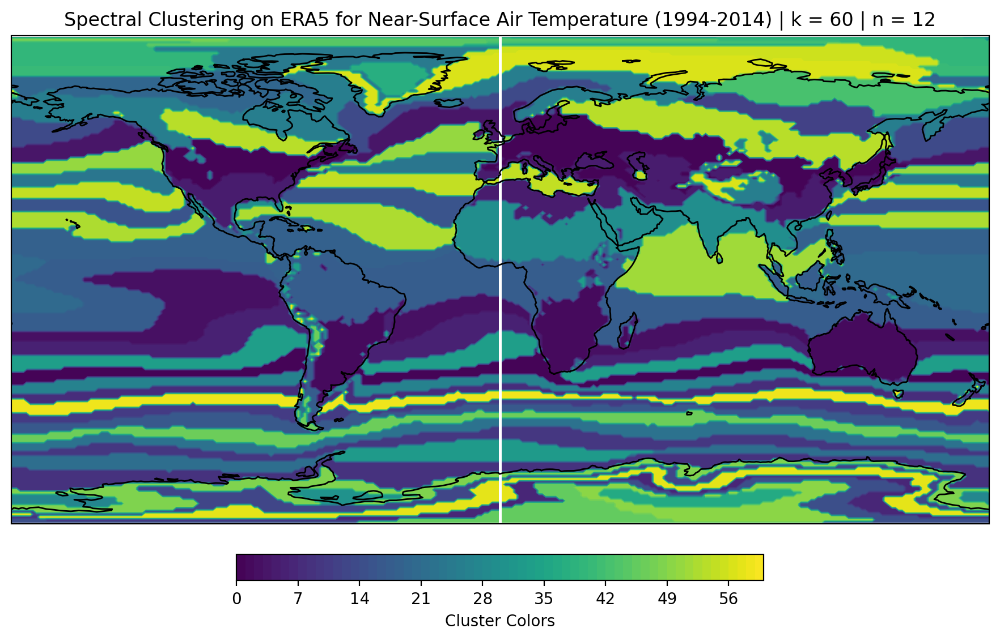

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


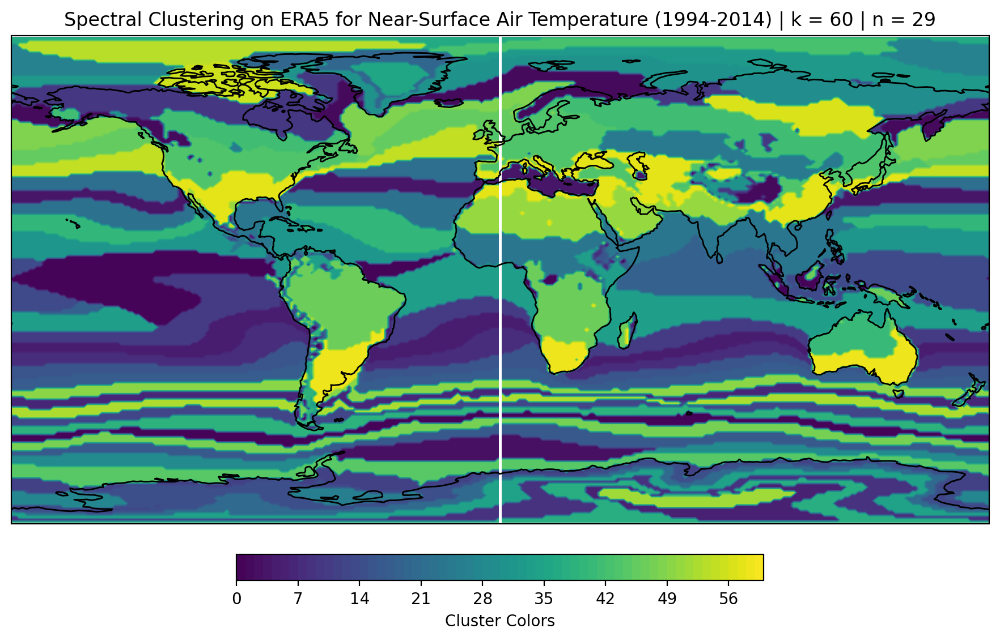

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


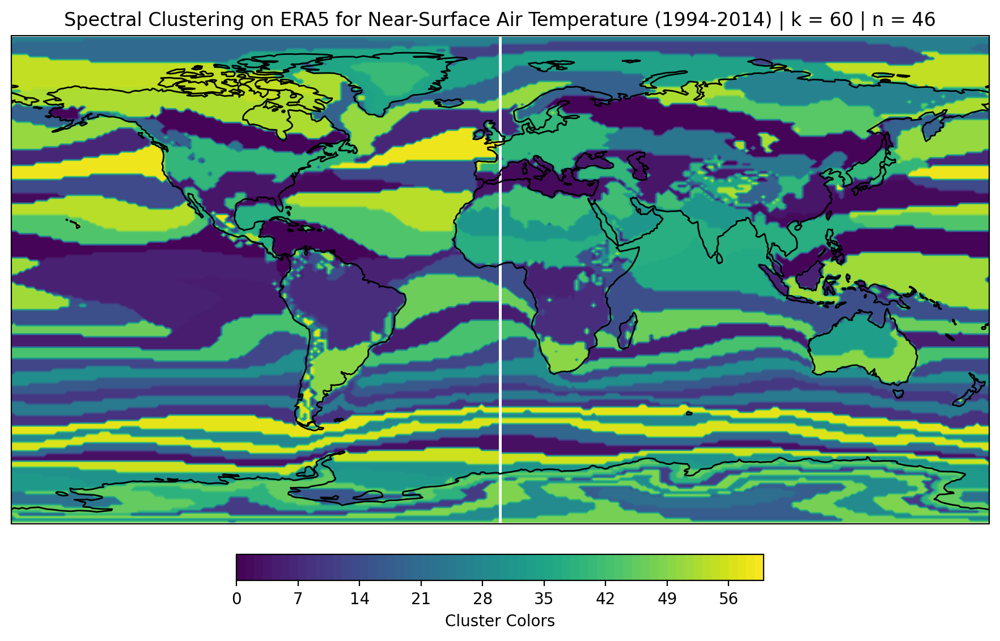

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


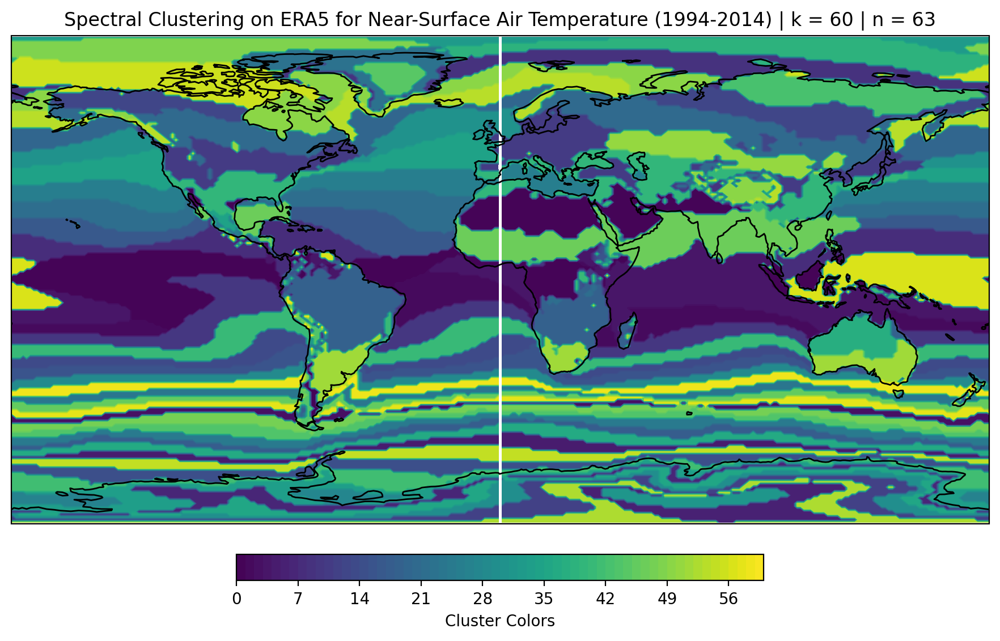

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


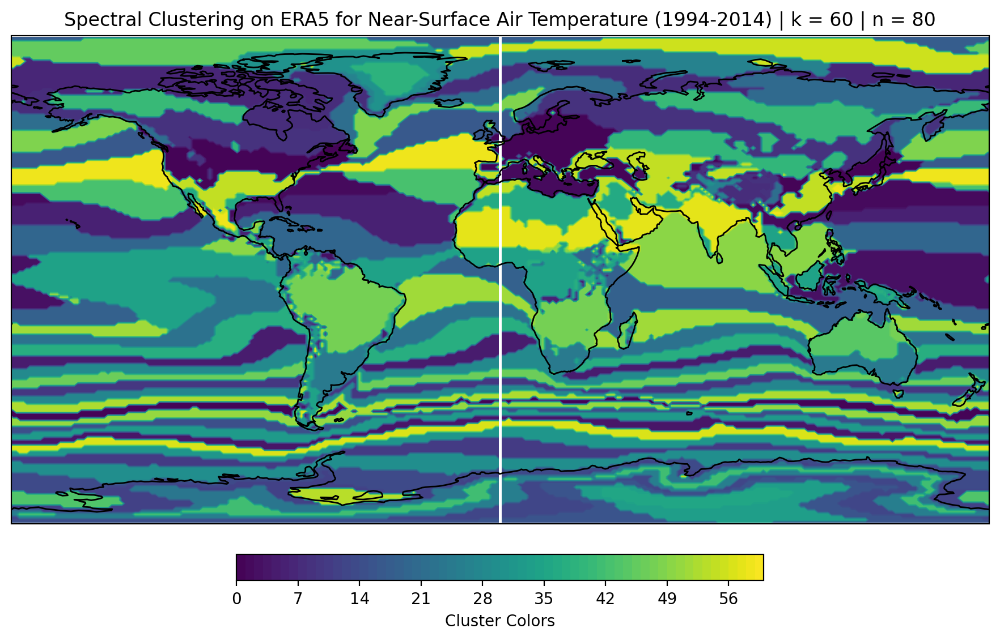

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


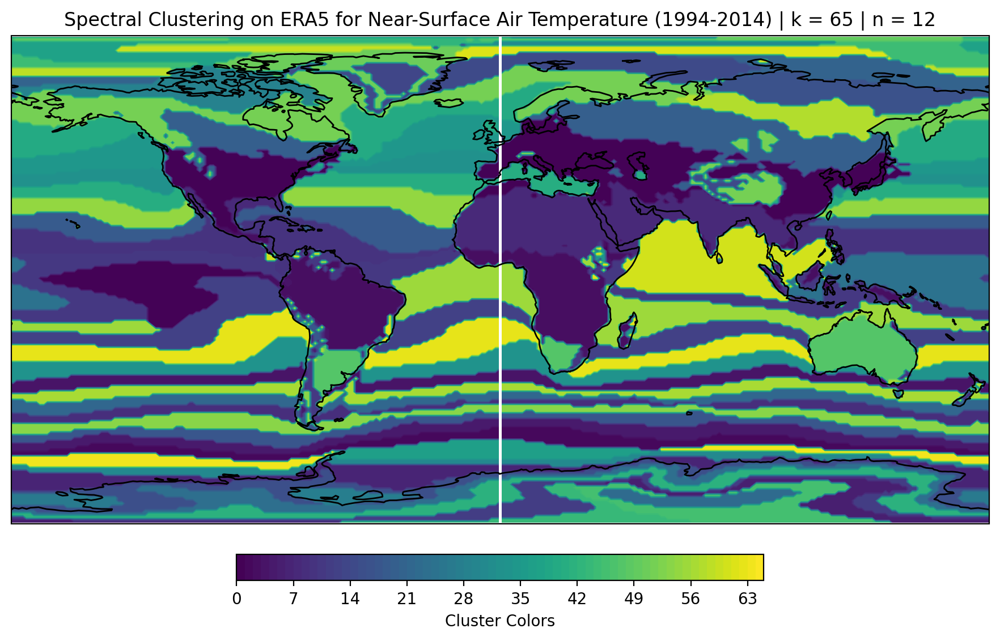

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


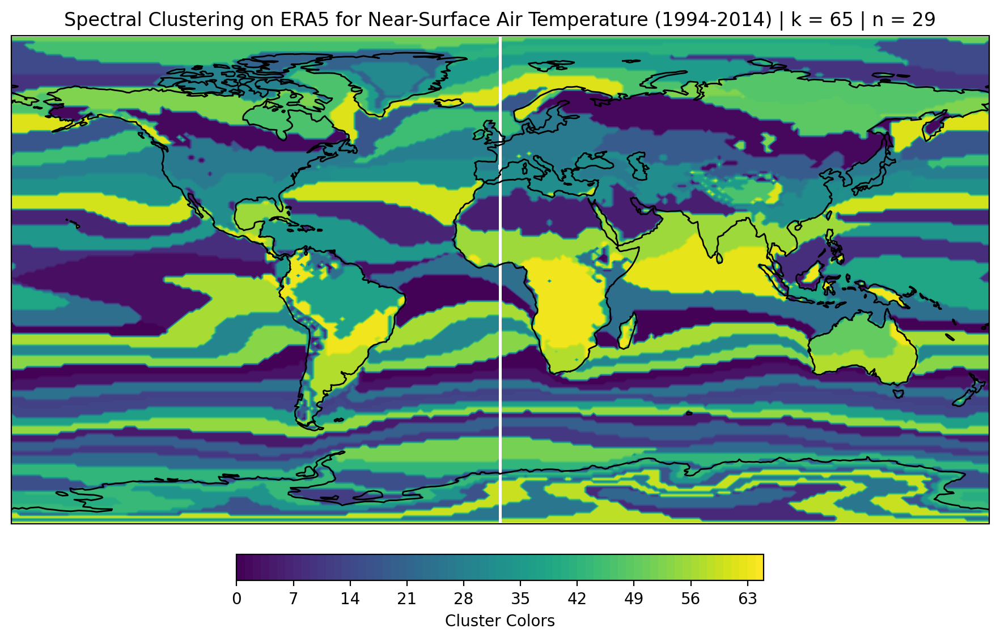

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


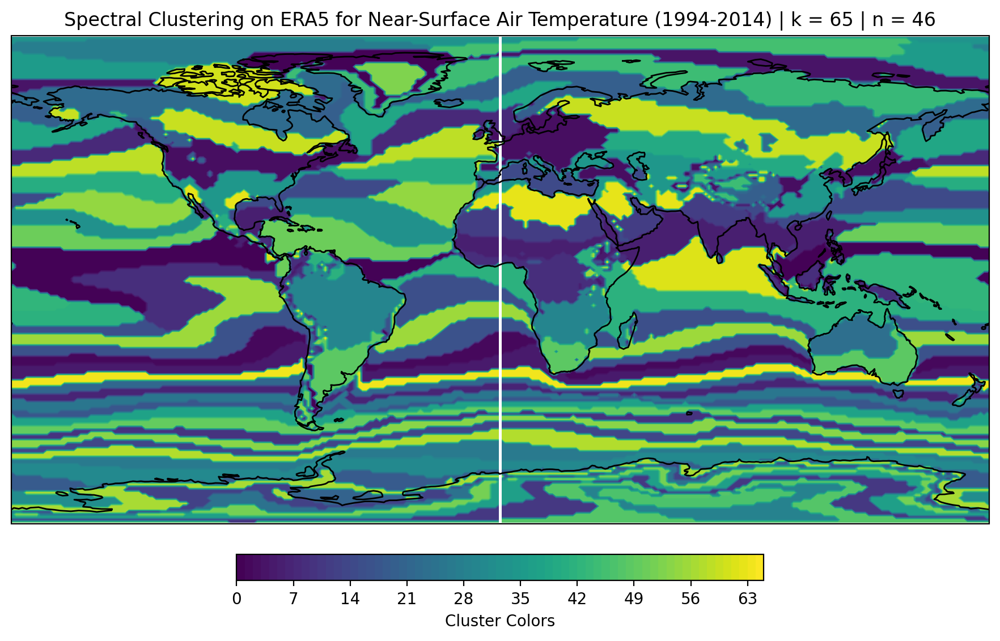

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


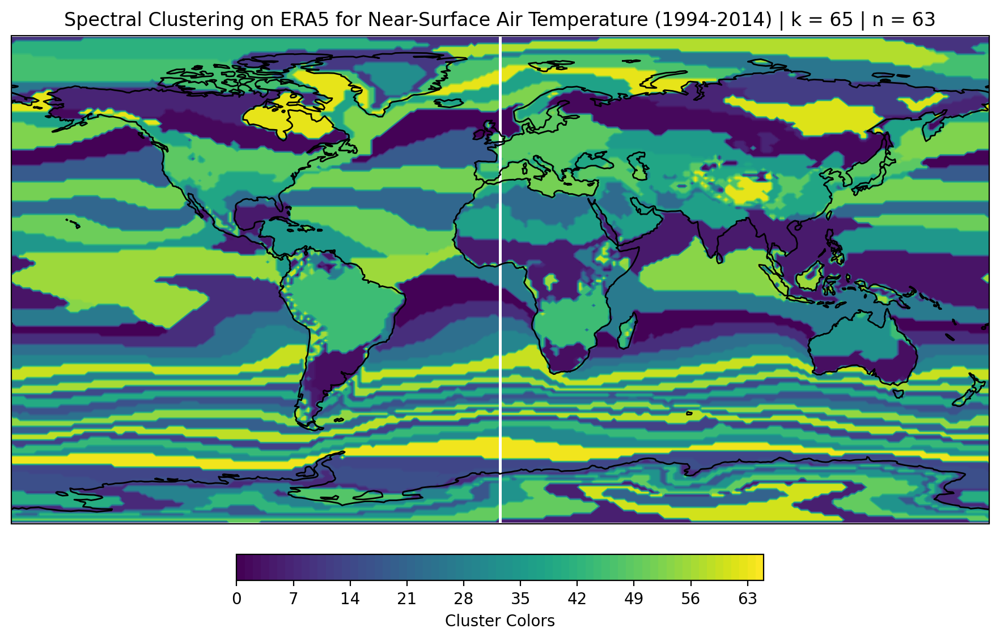

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


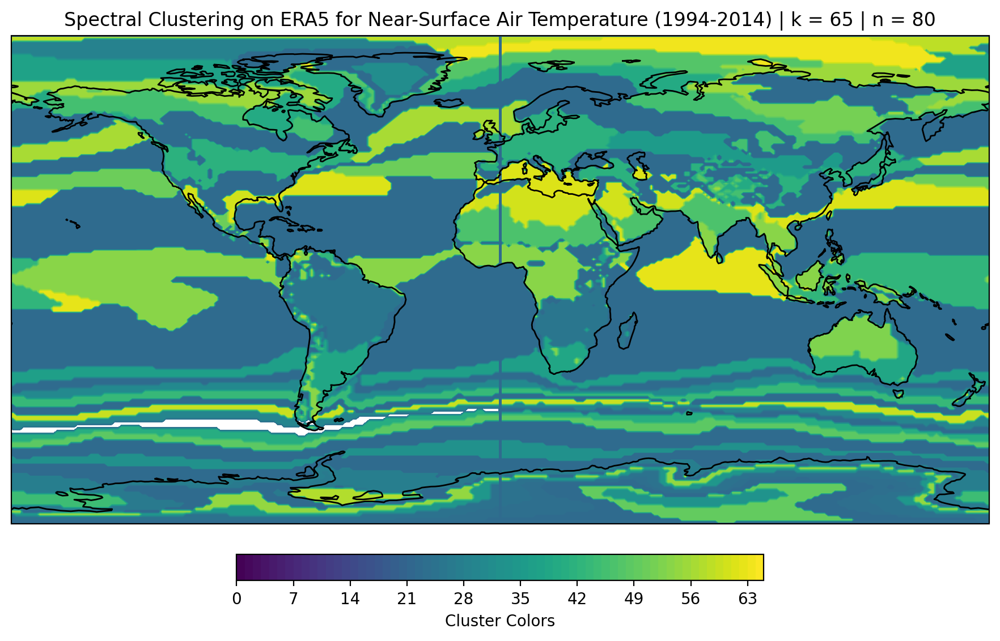

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


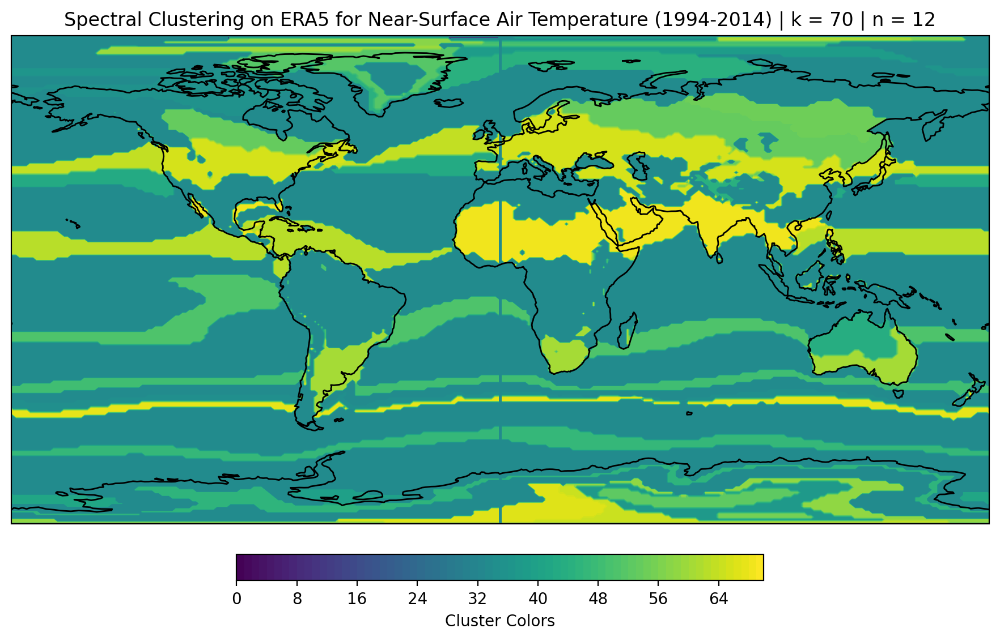

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


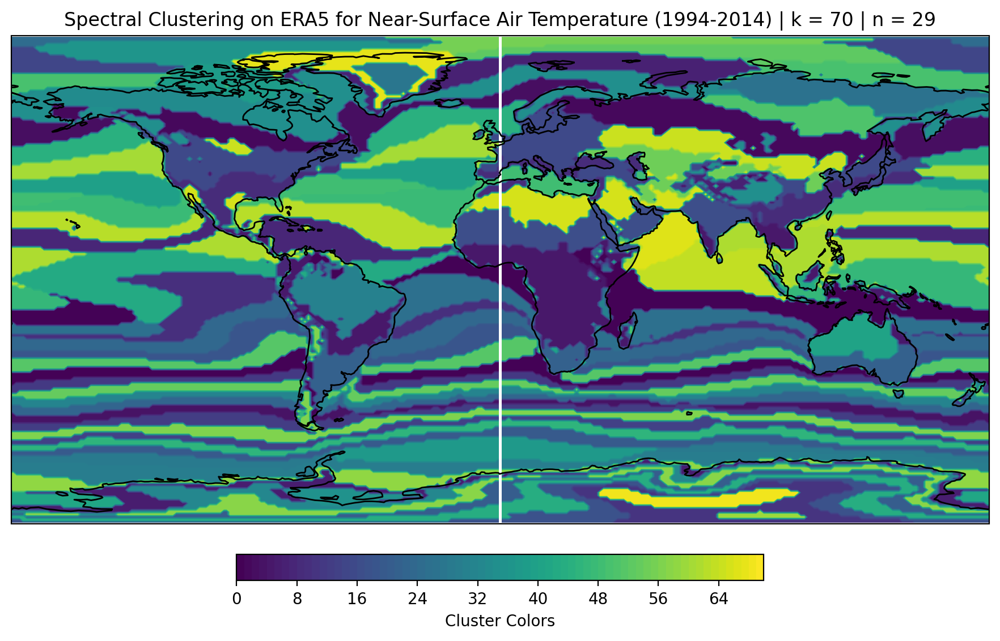

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


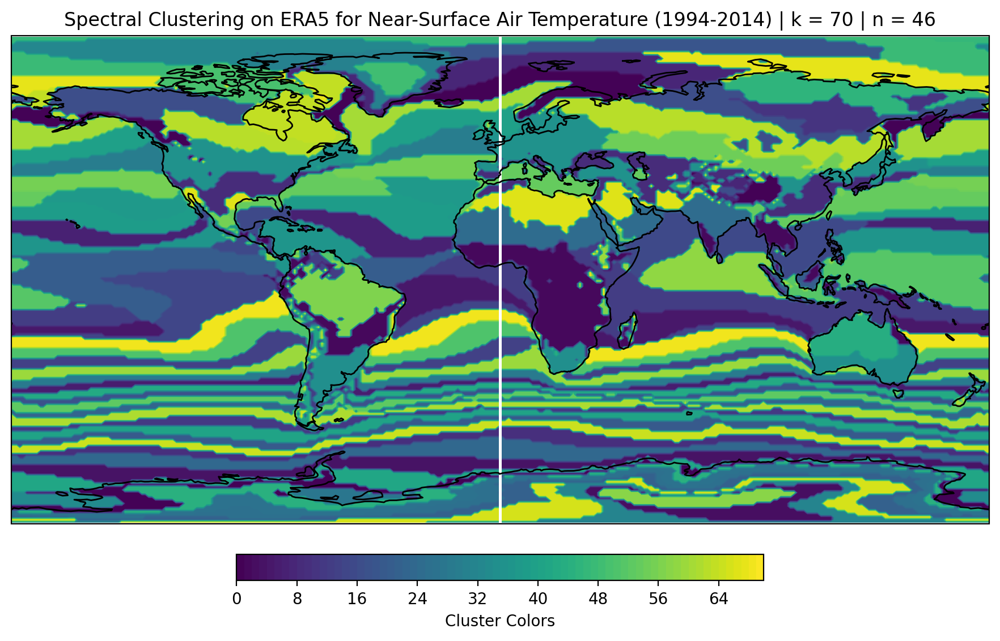

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


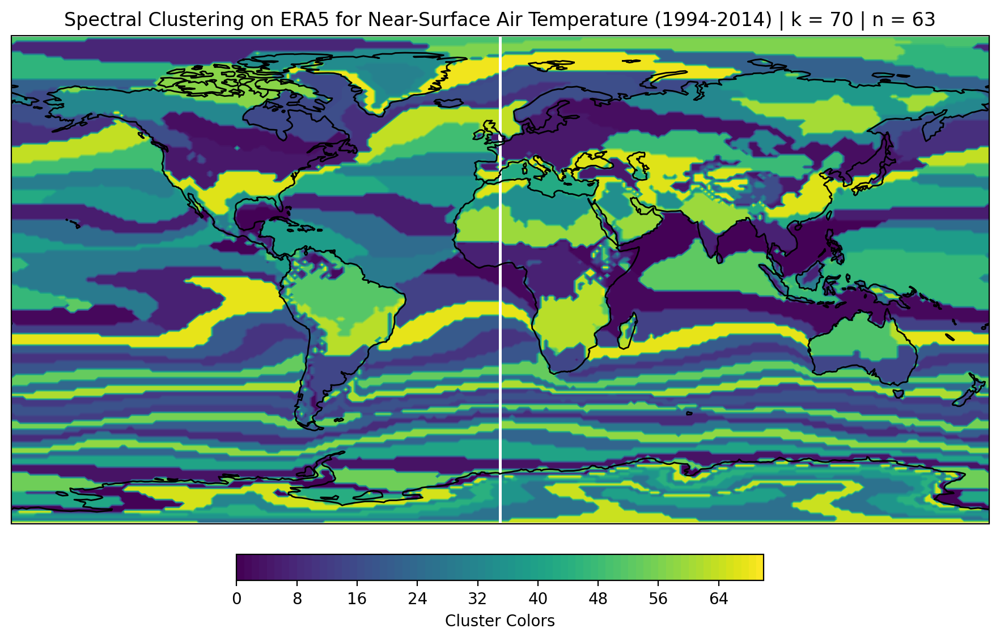

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


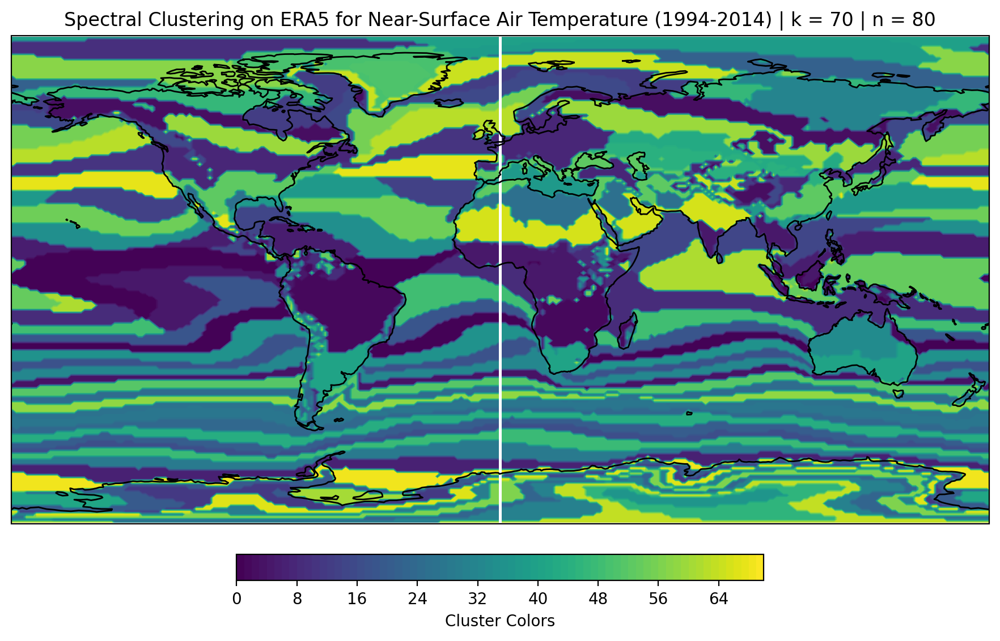

In [94]:
lons = np.linspace(0.625, 359.375, 288)
lats = np.linspace(89.5, -89.5, 180)

for k in range(30, 71, 5):
  for n in range(12, 81, 17):
    fig, ax = plt.subplots(figsize=(12, 7), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.set_global()
    ax.coastlines()
    cm = SpecClusterMap(era5, k, n)

    contour = ax.contourf(lons, lats, cm, levels=np.arange(k+1), cmap = 'viridis', transform=ccrs.PlateCarree())
    cbar = plt.colorbar(contour, ax=ax, orientation='horizontal', pad=0.05, shrink=0.5)
    cbar.set_label('Cluster Colors')

    plt.title('Spectral Clustering on ERA5 for Near-Surface Air Temperature (1994-2014) | k = ' + str(k) + ' | n = ' + str(n))
    plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:248:

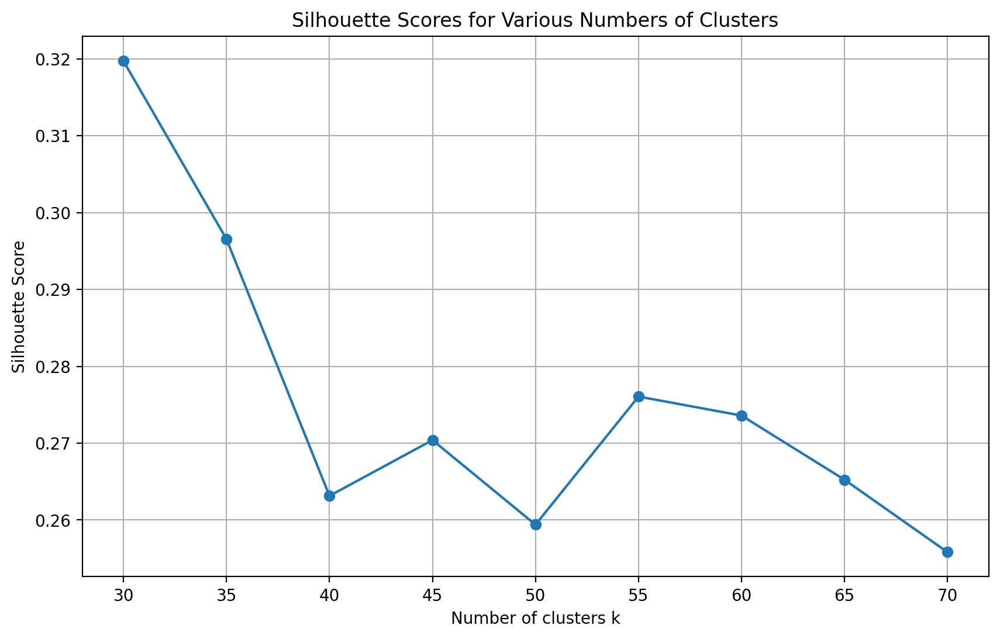

In [100]:
import numpy as np
import xarray as xr
import cftime
from sklearn.cluster import SpectralClustering
from sklearn.neighbors import kneighbors_graph
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Used to compute Silhouette Scores for different cluster numbers k
def Compute_Silhouette_Scores(dataset, k_range, n_neighbors):
    times = [cftime.DatetimeNoLeap(year, month, 15) for year in range(1994, 2015) for month in range(1, 13)]
    da = xr.DataArray(dataset, coords=[times, np.linspace(-89.5, 89.5, 180), np.linspace(.625, 359.375, 288)], dims=["time", "lat", "lon"])

    da.coords['month'] = ('time', [t.month for t in da.coords['time'].values])
    monthly_mean = da.groupby('month').mean('time')

    data_array = monthly_mean.values
    n_time, height, width = data_array.shape
    data_for_clustering = data_array.reshape(n_time, height * width).T

    silhouette_scores = []
    for k in k_range:
        connectivity = kneighbors_graph(data_for_clustering, n_neighbors=n_neighbors)
        spectral = SpectralClustering(n_clusters=k, affinity='precomputed', assign_labels='kmeans', random_state=0)
        labels = spectral.fit_predict(connectivity)
        score = silhouette_score(data_for_clustering, labels)
        silhouette_scores.append(score)

    return silhouette_scores

k_range = range(30, 71, 5)
silhouette_scores = Compute_Silhouette_Scores(era5, k_range, 64)

# Plot silhouette scores
plt.figure(figsize=(10, 6))
plt.plot(list(k_range), silhouette_scores, marker='o')
plt.title('Silhouette Scores for Various Numbers of Clusters')
plt.xlabel('Number of clusters k')
plt.ylabel('Silhouette Score')
plt.grid(True)
plt.show()

In [101]:
from sklearn.metrics import jaccard_score

# A function used to compute the Jaccard similarity between observational clusters and predictive clusters of best fit
def JaccardComparison(cluster_predictive, cluster_observational):
  unique_obs_clusters = np.unique(cluster_observational)
  unique_pred_clusters = np.unique(cluster_predictive)

  best_matches = []

  # Loop through each observational cluster to find its best match in predictive clusters
  for obs_cluster in unique_obs_clusters:
      obs_mask = (cluster_observational == obs_cluster).astype(int).flatten()
      best_jaccard = -1
      best_cluster = None

      # Compare with each predictive cluster
      for pred_cluster in unique_pred_clusters:
          pred_mask = (cluster_predictive == pred_cluster).astype(int).flatten()
          jaccard_index = jaccard_score(obs_mask, pred_mask)
          if jaccard_index > best_jaccard:
              best_jaccard = jaccard_index
              best_cluster = pred_cluster

      # Store the best match for this observational cluster
      best_matches.append((obs_cluster, best_cluster, best_jaccard))

  return best_matches